# Google Mobility Reportによる各国・地域での人の移動量の可視化ノートブック
COVID19後に、人の移動量がどの程度変動したのかを、Googleが公開している[Google Mobility Report](https://www.google.com/covid19/mobility/)のデータを利用して可視化する。
いずれも、2020年1月での移動量を基準値として、その基準値と比較した割合として移動量を表示する。

# 関連パッケージのインストール
初回のみ実行が必要。
実効後にコメントアウトすると良い。

In [1]:
!conda install -y pandas numpy matplotlib

Solving environment: done

# All requested packages already installed.



# 初期化

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pprint import pprint
%matplotlib inline

In [2]:
%%html

<style>
    .jp-OutputArea-child {
        display: inline-block;
    }
</style>

# データ取得
GoogleのGlobal Mobility Reportファイルをダウンロードしてカレントディレクトリに置き、それをdfとして読み込む。

In [3]:
!wget https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv -O data/Global_Mobility_Report.csv
df = pd.read_csv("data/Global_Mobility_Report.csv")
df

--2021-04-27 20:43:58--  https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv
www.gstatic.com (www.gstatic.com) をDNSに問いあわせています... 2404:6800:4004:822::2003, 142.250.196.131
www.gstatic.com (www.gstatic.com)|2404:6800:4004:822::2003|:443 に接続しています... 接続しました。
HTTP による接続要求を送信しました、応答を待っています... 200 OK
長さ: 502712484 (479M) [text/csv]
`data/Global_Mobility_Report.csv' に保存中

data/Global_Mobilit 100%[===================>] 479.42M  9.82MB/s    in 50s     

2021-04-27 20:44:48 (9.62 MB/s) - `data/Global_Mobility_Report.csv' へ保存完了 [502712484/502712484]



/home/seagetch/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (4,5) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,country_region_code,country_region,sub_region_1,sub_region_2,metro_area,iso_3166_2_code,census_fips_code,place_id,date,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
0,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-15,0.0,4.0,5.0,0.0,2.0,1.0
1,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-16,1.0,4.0,4.0,1.0,2.0,1.0
2,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-17,-1.0,1.0,5.0,1.0,2.0,1.0
3,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-18,-2.0,1.0,5.0,0.0,2.0,1.0
4,AE,United Arab Emirates,NaN,NaN,NaN,NaN,NaN,ChIJvRKrsd9IXj4RpwoIwFYv0zM,2020-02-19,-2.0,0.0,4.0,-1.0,2.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5126519,ZW,Zimbabwe,Midlands Province,Kwekwe,NaN,NaN,NaN,ChIJRcIZ3-FJNBkRRsj55IcLpfU,2021-04-19,NaN,NaN,NaN,NaN,-52.0,NaN
5126520,ZW,Zimbabwe,Midlands Province,Kwekwe,NaN,NaN,NaN,ChIJRcIZ3-FJNBkRRsj55IcLpfU,2021-04-20,NaN,NaN,NaN,NaN,18.0,NaN
5126521,ZW,Zimbabwe,Midlands Province,Kwekwe,NaN,NaN,NaN,ChIJRcIZ3-FJNBkRRsj55IcLpfU,2021-04-21,NaN,NaN,NaN,NaN,19.0,NaN
5126522,ZW,Zimbabwe,Midlands Province,Kwekwe,NaN,NaN,NaN,ChIJRcIZ3-FJNBkRRsj55IcLpfU,2021-04-22,NaN,NaN,NaN,NaN,16.0,NaN


# 国名の確認
レポートに含まれる国の一覧を確認する。

In [4]:
group = df.groupby("country_region")
countries = [x for x,y in group]
pprint(countries, compact=True)

['Afghanistan', 'Angola', 'Antigua and Barbuda', 'Argentina', 'Aruba',
 'Australia', 'Austria', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus',
 'Belgium', 'Belize', 'Benin', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana',
 'Brazil', 'Bulgaria', 'Burkina Faso', 'Cambodia', 'Cameroon', 'Canada',
 'Cape Verde', 'Chile', 'Colombia', 'Costa Rica', 'Croatia', 'Czechia',
 "Côte d'Ivoire", 'Denmark', 'Dominican Republic', 'Ecuador', 'Egypt',
 'El Salvador', 'Estonia', 'Fiji', 'Finland', 'France', 'Gabon', 'Georgia',
 'Germany', 'Ghana', 'Greece', 'Guatemala', 'Guinea-Bissau', 'Haiti',
 'Honduras', 'Hong Kong', 'Hungary', 'India', 'Indonesia', 'Iraq', 'Ireland',
 'Israel', 'Italy', 'Jamaica', 'Japan', 'Jordan', 'Kazakhstan', 'Kenya',
 'Kuwait', 'Kyrgyzstan', 'Laos', 'Latvia', 'Lebanon', 'Libya', 'Liechtenstein',
 'Lithuania', 'Luxembourg', 'Malaysia', 'Mali', 'Malta', 'Mauritius', 'Mexico',
 'Moldova', 'Mongolia', 'Morocco', 'Mozambique', 'Myanmar (Burma)', 'Namibia',
 'Nepal', 'Netherlands',

In [5]:
df.columns

Index(['country_region_code', 'country_region', 'sub_region_1', 'sub_region_2',
       'metro_area', 'iso_3166_2_code', 'census_fips_code', 'place_id', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline'],
      dtype='object')

# 移動量の特徴可視化

## 初期設定

### 列名とその表示名の設定
レポート中で分析対象とするデータ列名(situation)と、その表示名(sit_legends)を設定する。


In [6]:
situations=[
    "retail_and_recreation_percent_change_from_baseline",
    "grocery_and_pharmacy_percent_change_from_baseline",
    "parks_percent_change_from_baseline",
    "transit_stations_percent_change_from_baseline",
    "workplaces_percent_change_from_baseline",
    "residential_percent_change_from_baseline"
]
sit_legends=[
    "retail&recreation",
    "grocery&pharmacy",
    "parks",
    "transit at station",
    "workplace",
    "residential"
]

## 移動量概要のレポート
いくつかの国の月ごとの移動量の変化をサマリとして表示する

In [2]:
countries = ["Japan", "South Korea", "Germany", "France", "United Kingdom", "Sweden", "United States"]
df["date"] = pd.to_datetime(df["date"])
df2 = df.loc[df["country_region"].isin(countries)].loc[df["sub_region_1"].isnull()].loc[df["metro_area"].isnull()]

# 平日のみを対象とする
df2 = df2.loc[df["date"].dt.weekday < 5]

def analysis_on_country(df):
    df3 = df.groupby([df["date"].dt.year, df["date"].dt.month, df["country_region"]]).apply(lambda df: df.mean())
    for c,df4 in df3.groupby(level=[0, 1]):
        df4[situations].plot(kind="barh", title="%s-%s"%(df4.index[0], ""), figsize=(5, 12), subplots=True, sharex=True, legend=False, xlim=[-100, 100], grid=True)
    return None

#df2.set_index("country_region").groupby("country_region").apply(analysis_on_country)
analysis_on_country(df2)

NameError: name 'pd' is not defined

## 各国の可視化

### 分析する地域、国名の設定
各地域ごとに調査する国名を設定する



In [8]:
FEAsiaSample=["Japan", "South Korea", "Taiwan", "Philippines", "Singapore", "Indonesia","Malaysia","Australia"]
EuropeSample=["Germany", "France", "Italy", "United Kingdom", "Spain", "Netherlands", "Sweden", "Norway", "Russia"]
AmericaSample=["United States", "Canada", "Brazil", "Argentina", "Chile","Colombia","Peru","Bolivia"]
AfricaSample=["Egypt", "Nigeria", "South Africa", "Kenya"]
AsiaSample=["India", "Iraq", "Israel", "Ukraine", "Saudi Arabia", "Pakistan", "Kazakhstan", "Turkey", "Bangladesh" ]

Areas={
    "Far East & Oceania": FEAsiaSample, 
    "Europe": EuropeSample,
    "America": AmericaSample,
    "Africa": AfricaSample,
    "Asia": AsiaSample,
      }


### 国別の移動量の時系列表示

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


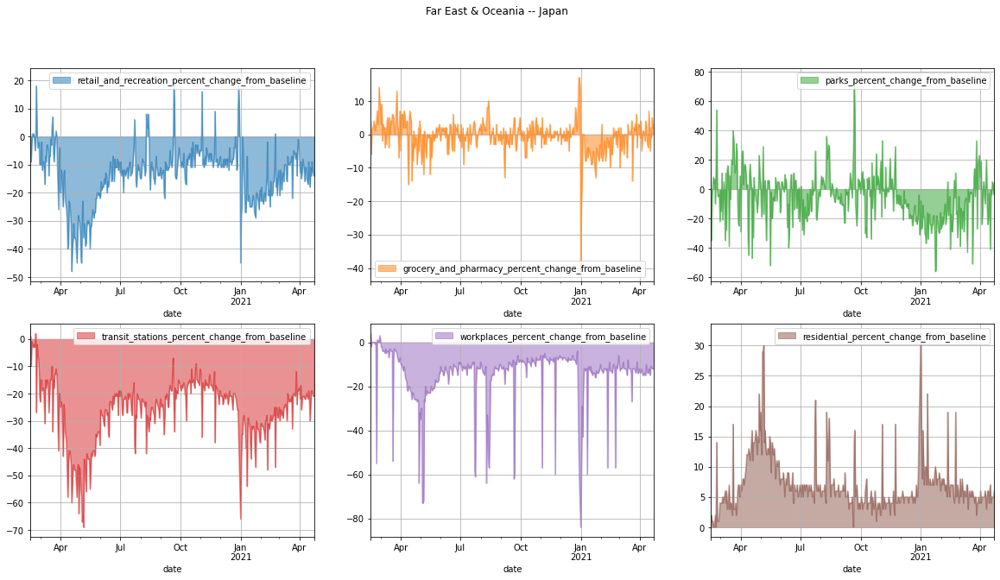

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


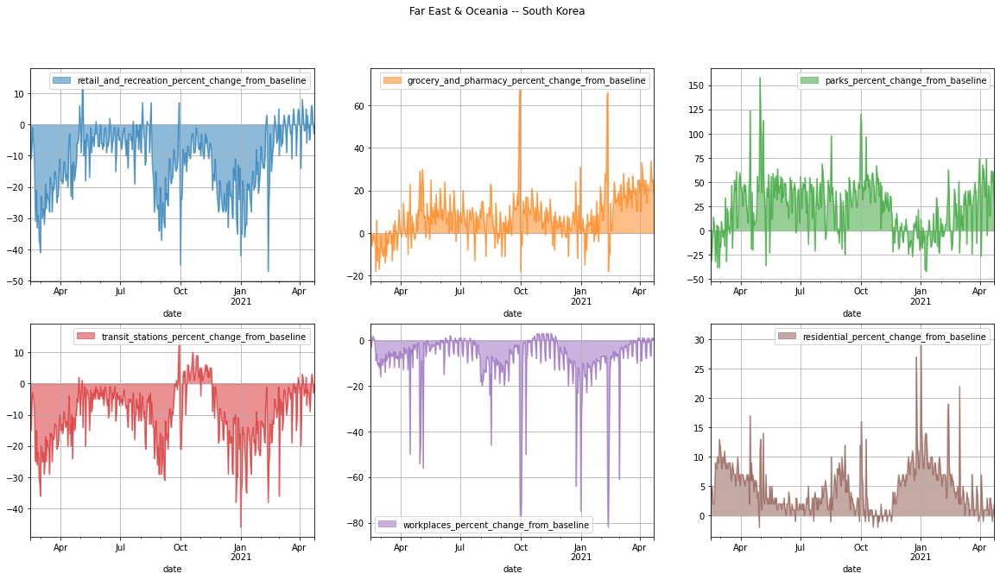

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


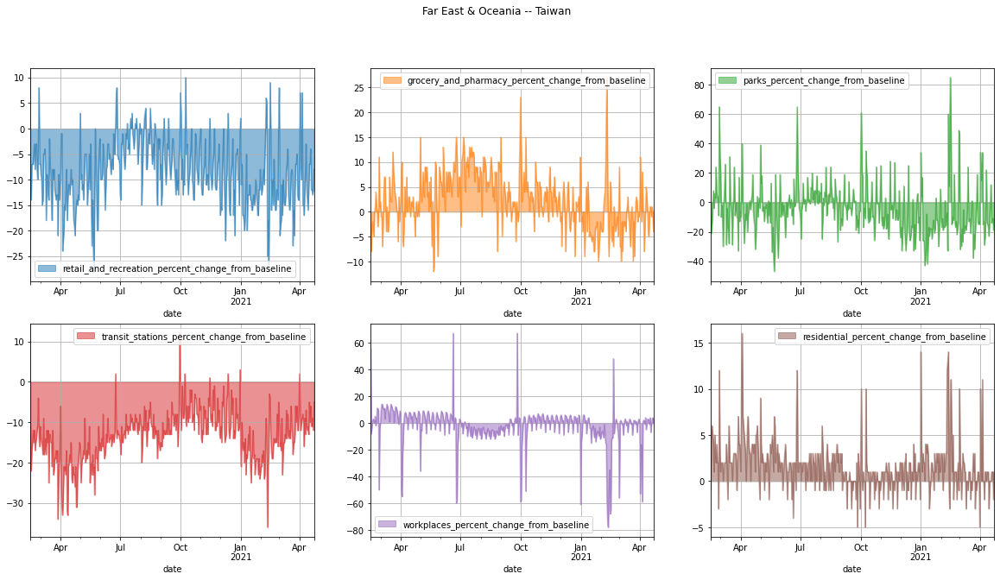

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


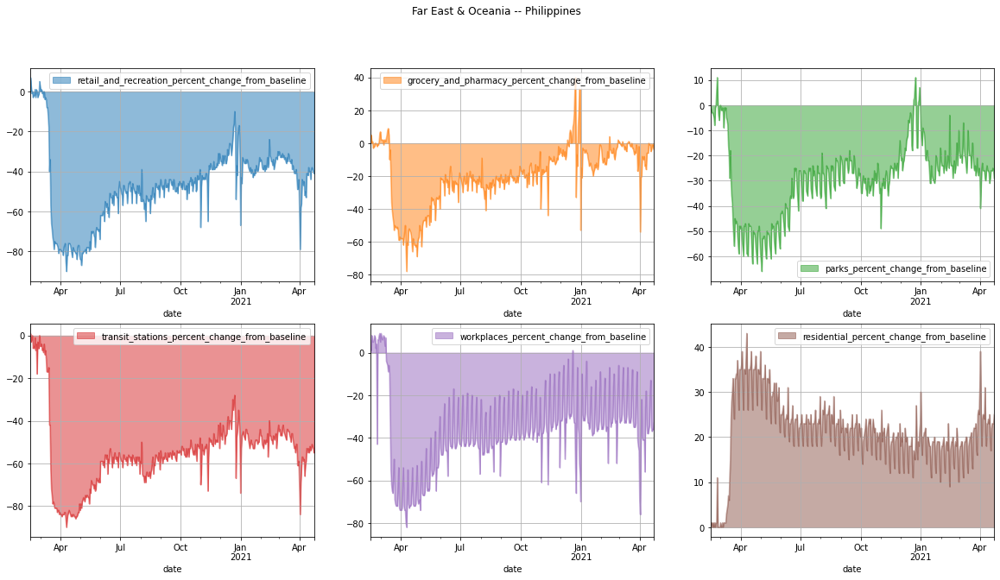

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


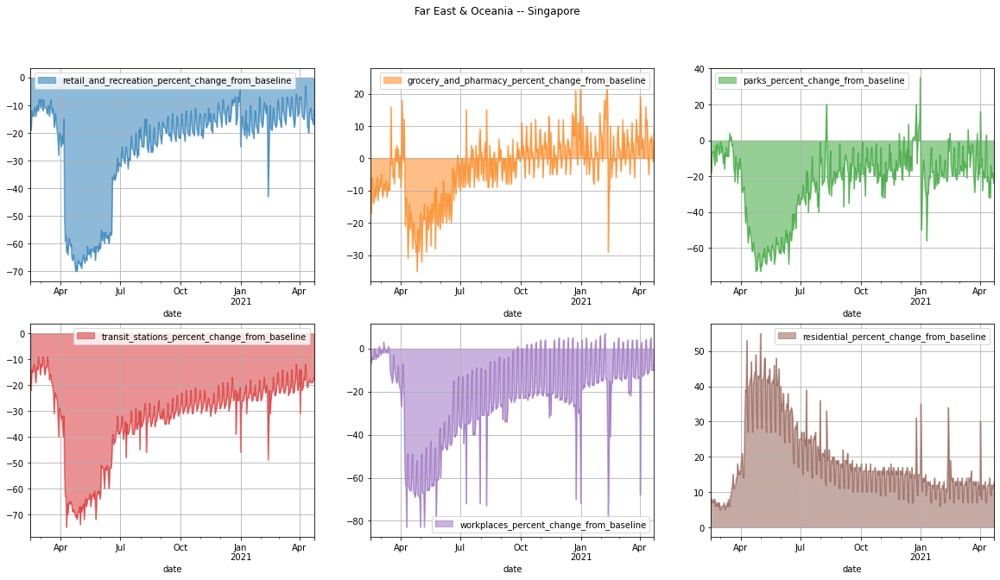

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


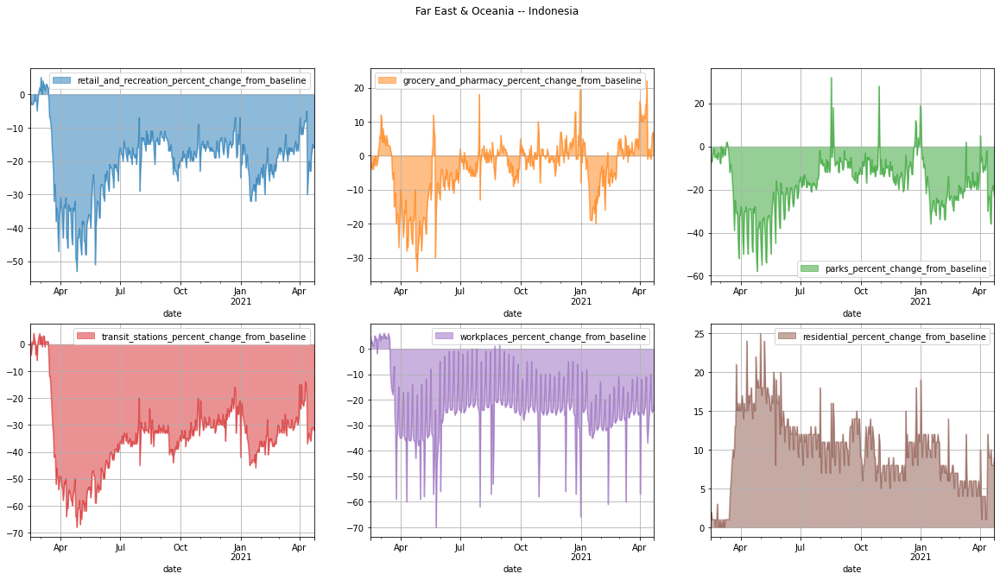

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


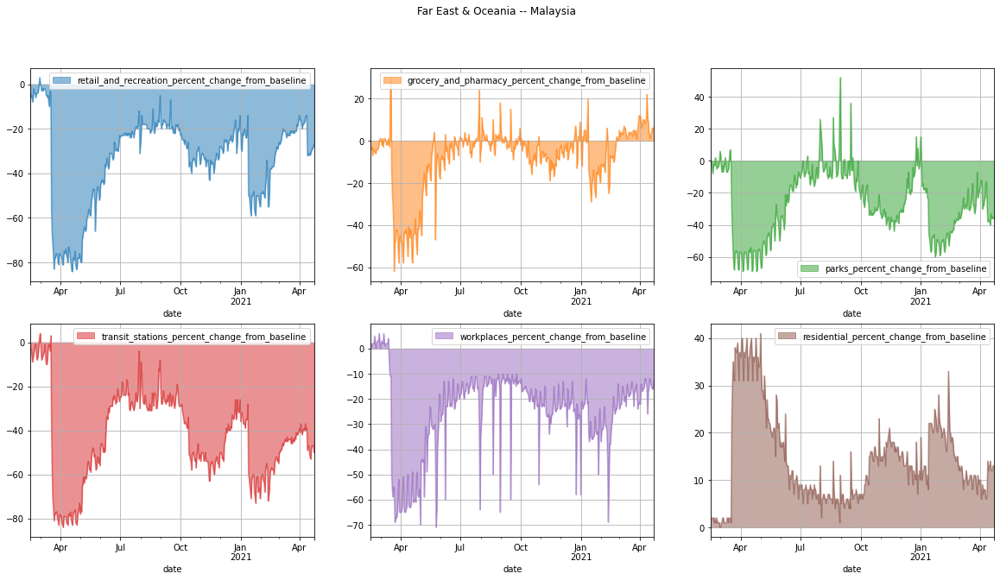

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


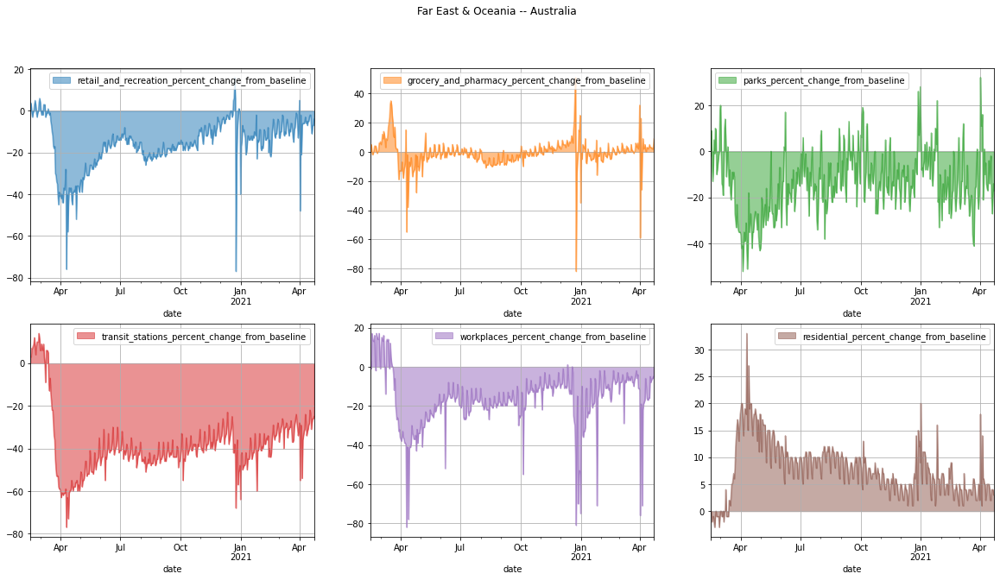

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


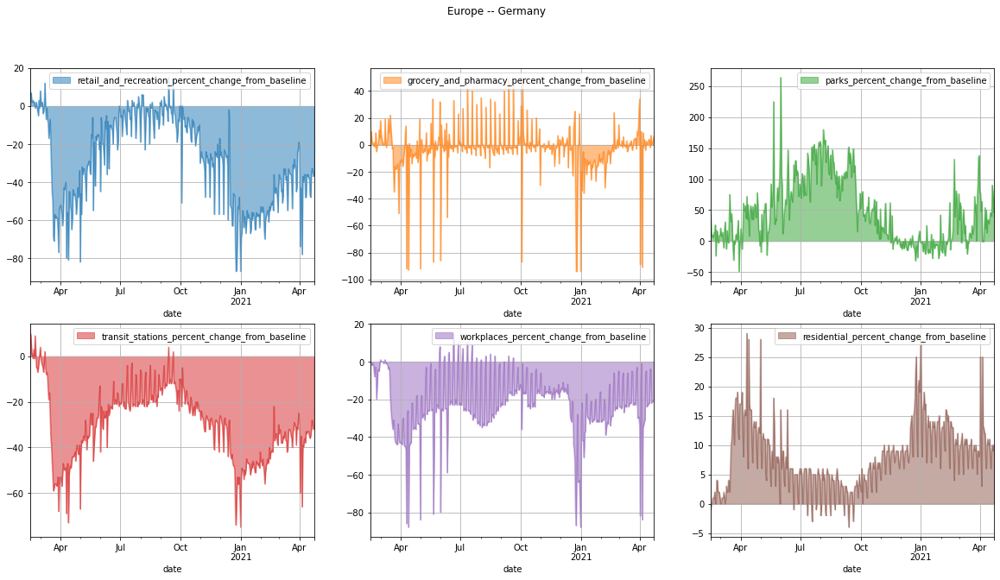

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


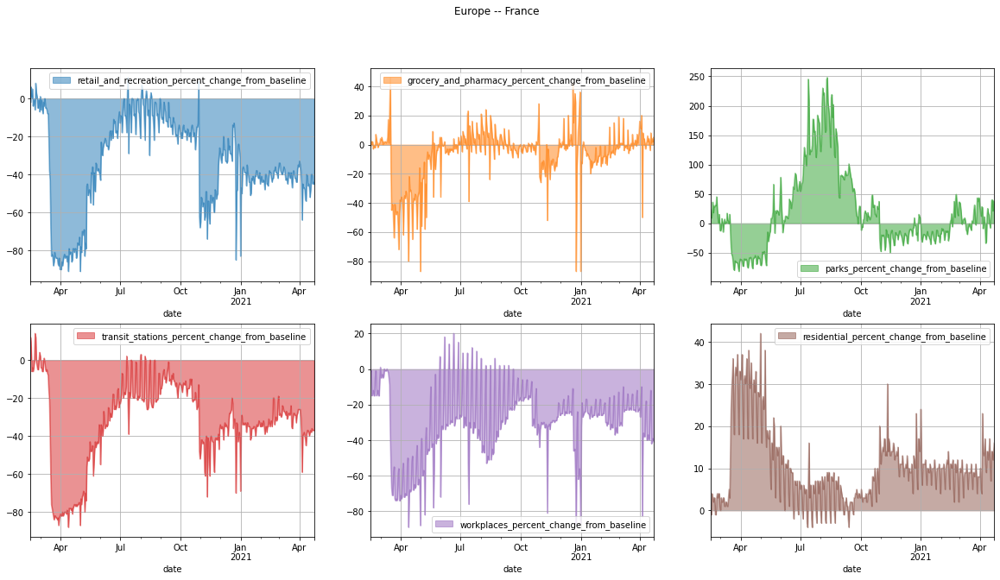

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


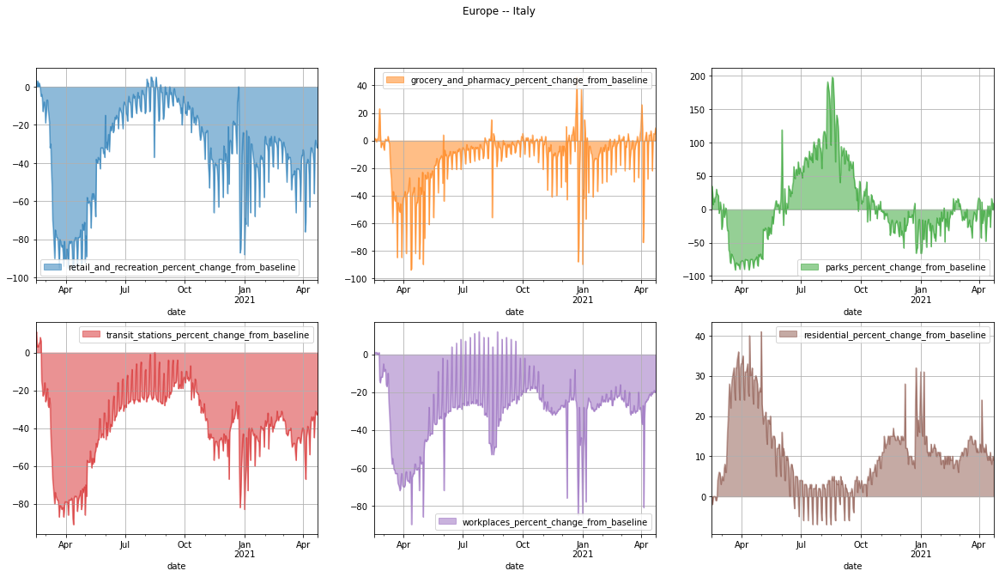

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


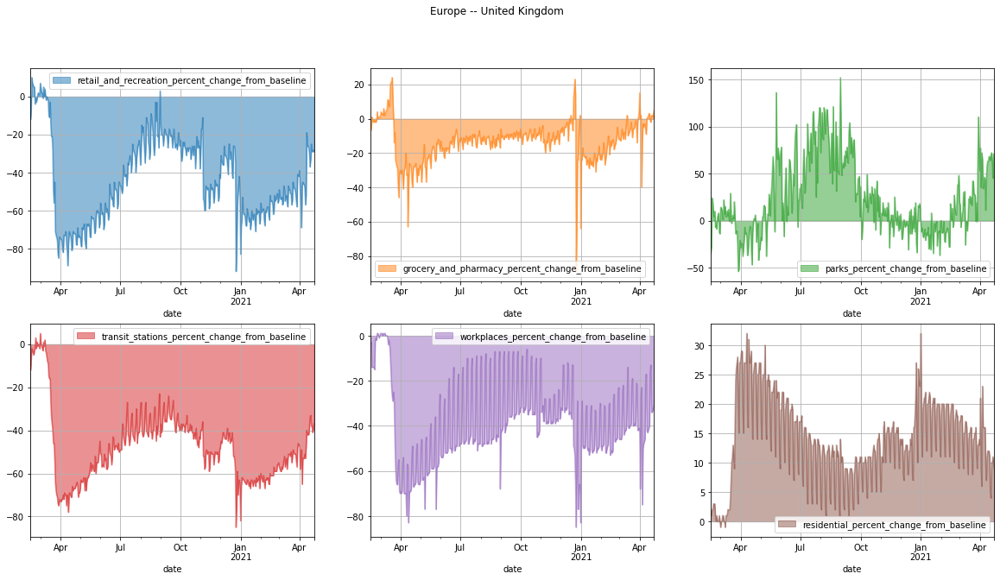

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


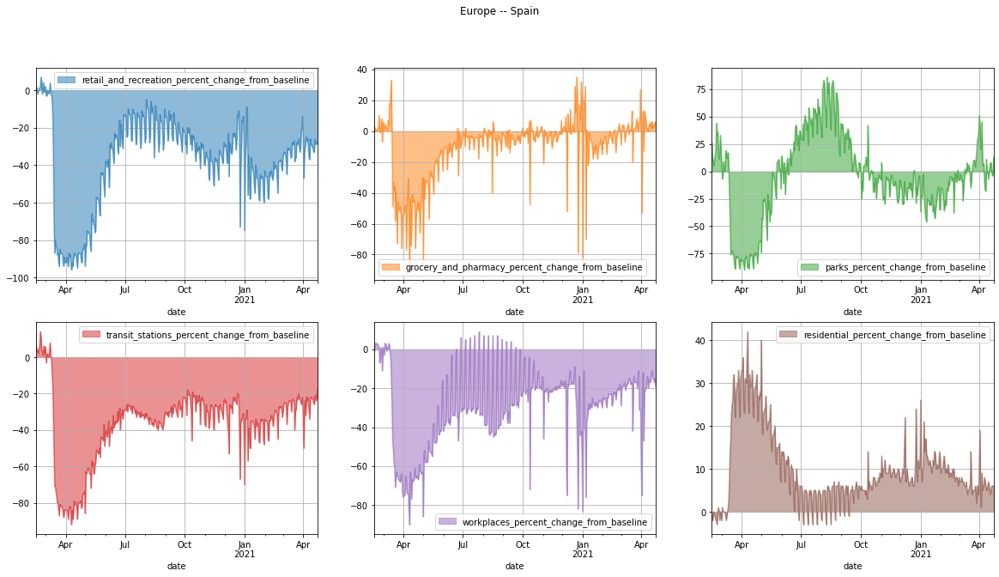

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


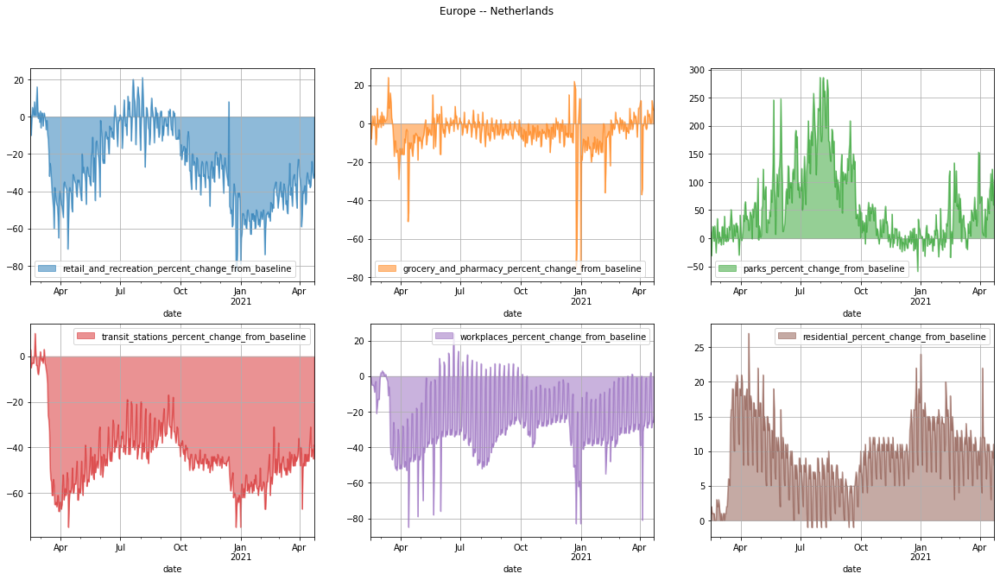

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


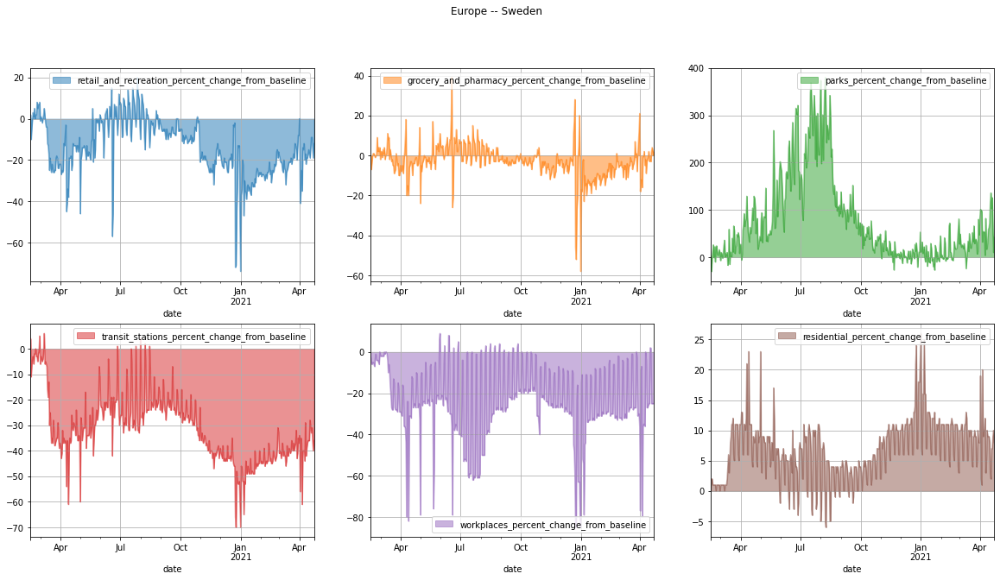

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


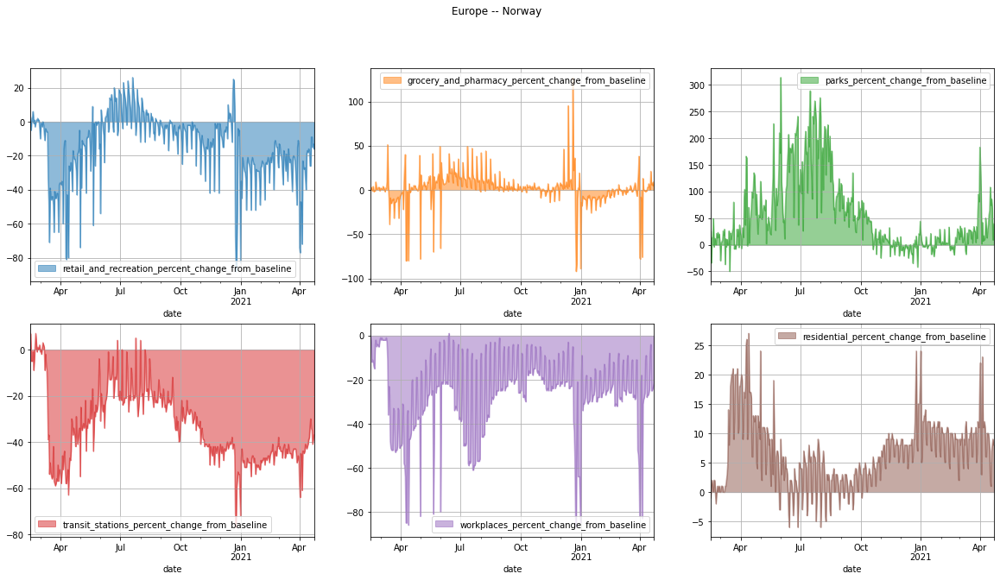

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


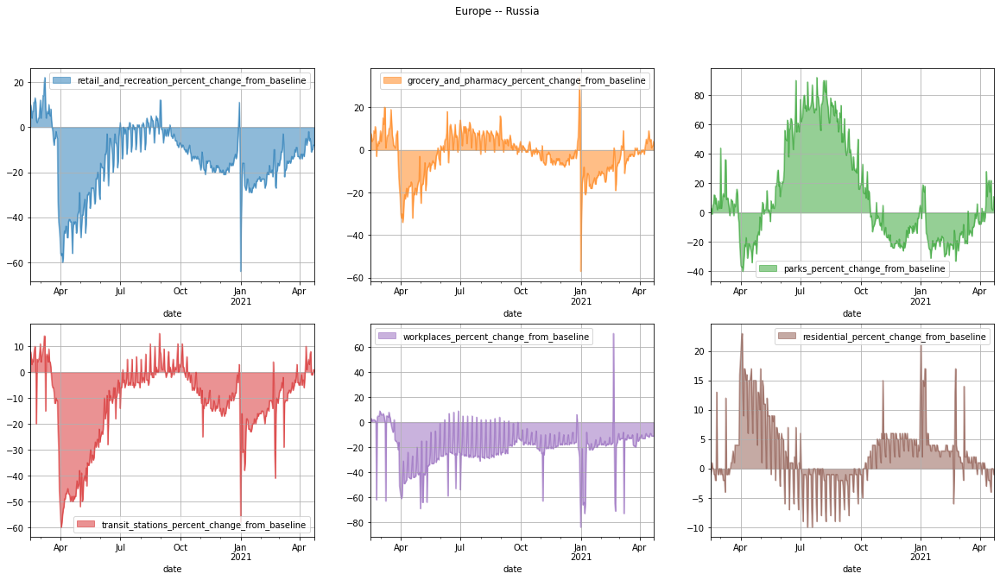

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


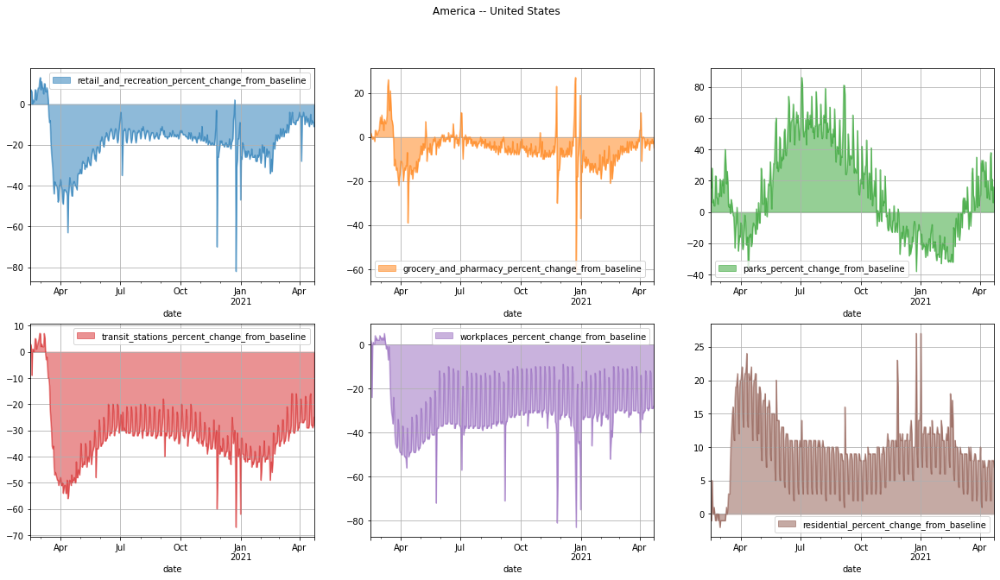

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


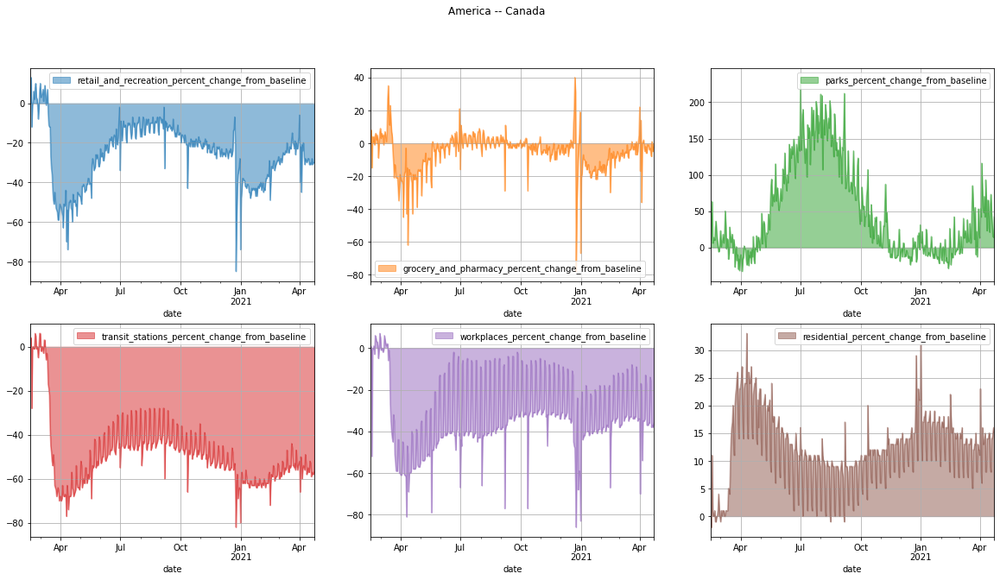

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


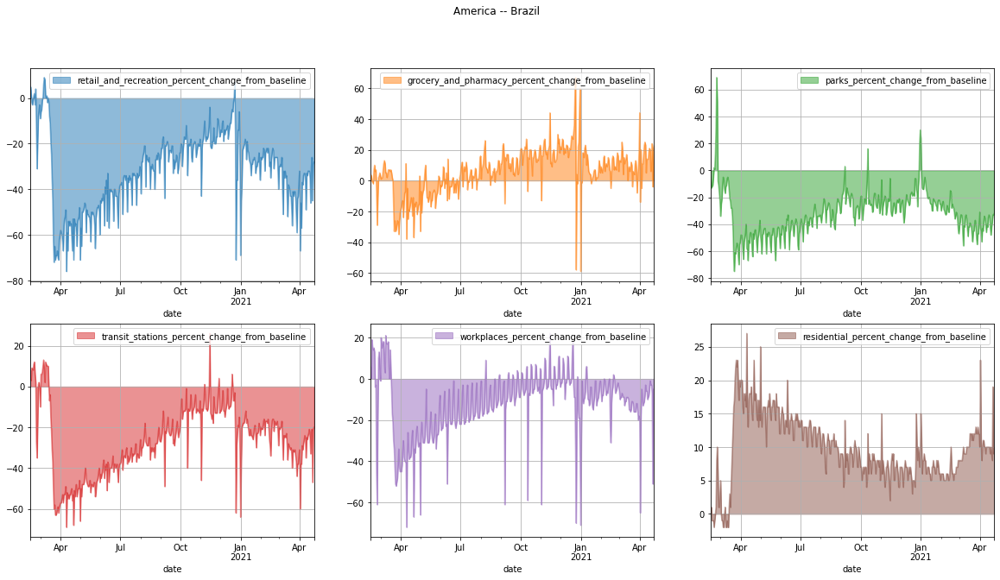

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


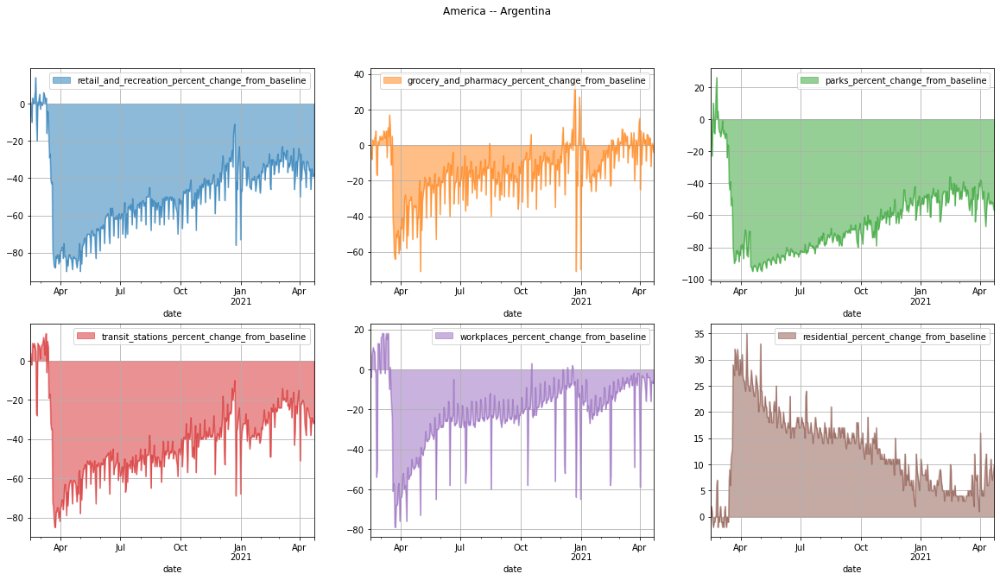

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


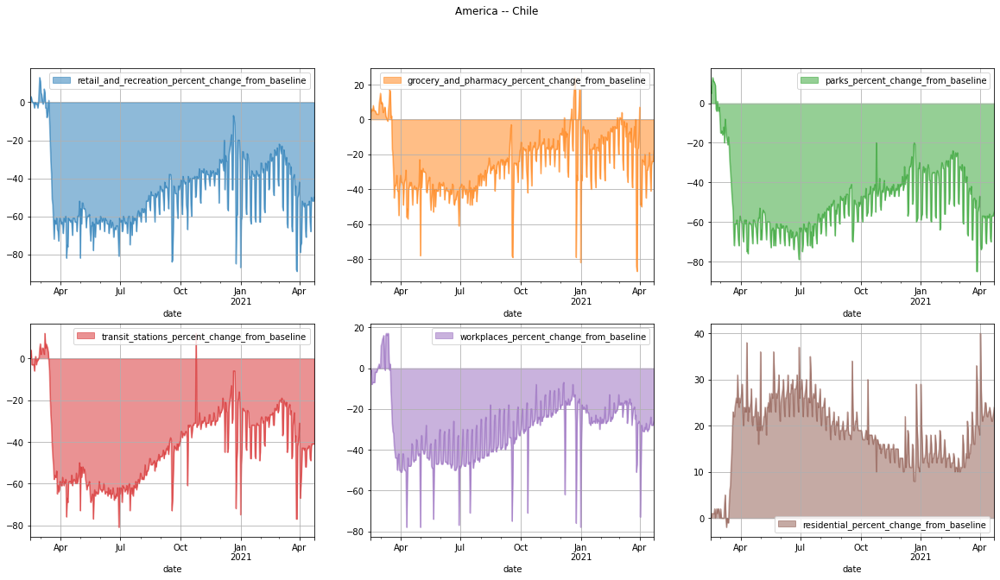

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


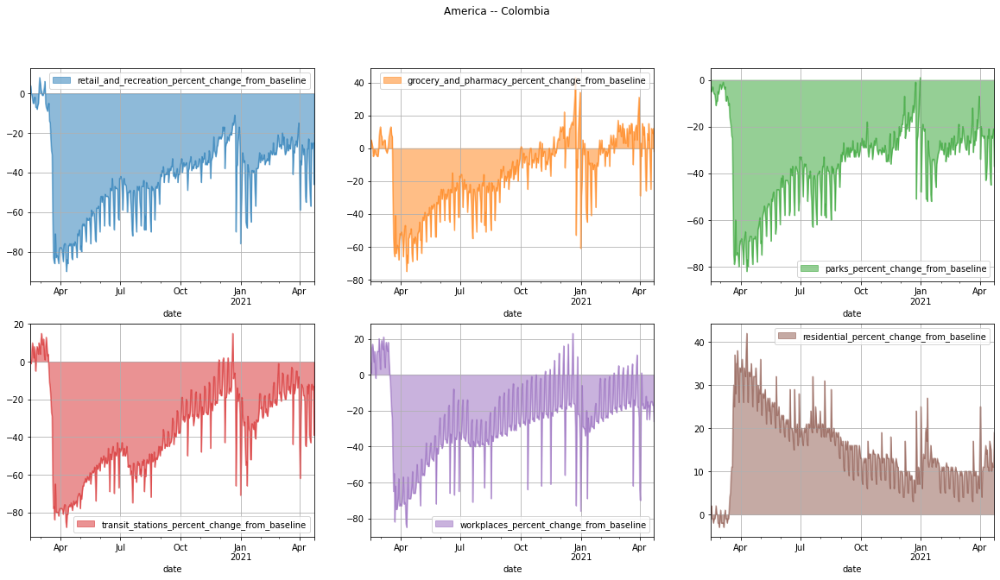

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


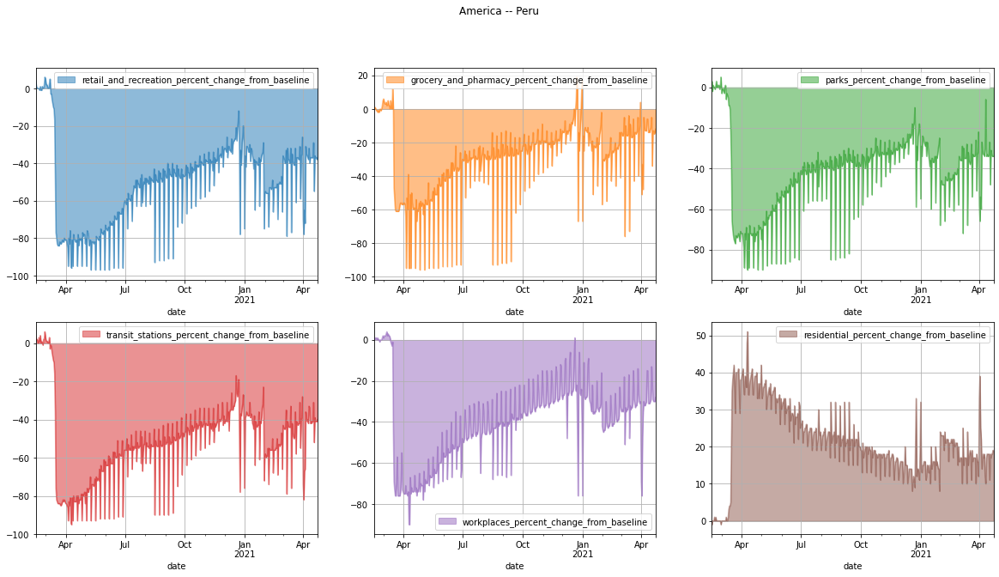

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


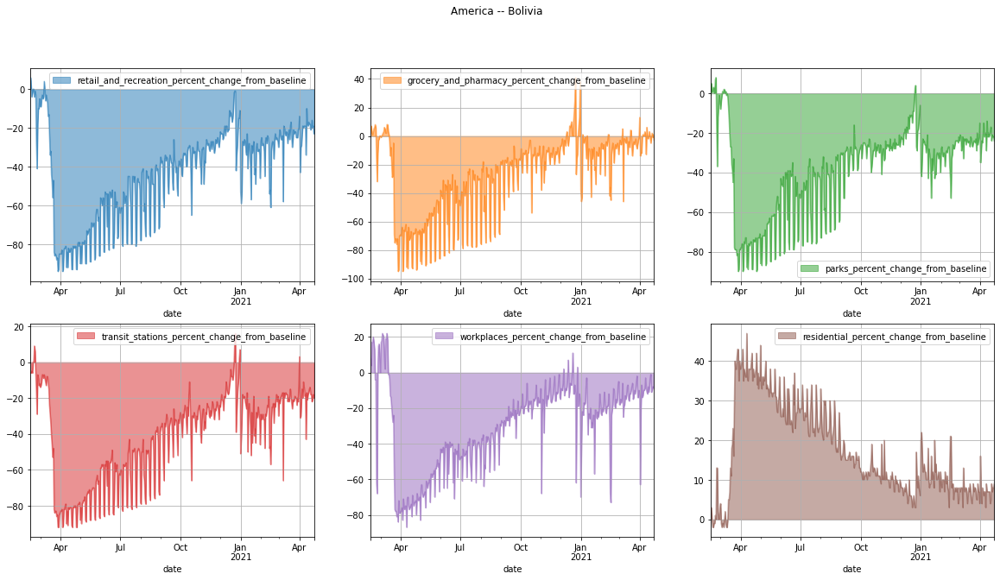

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


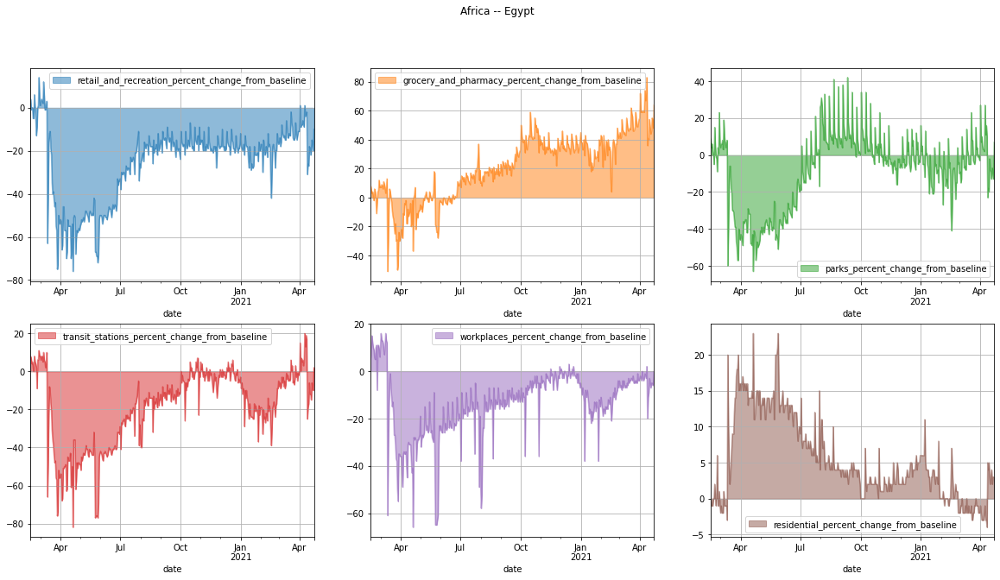

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


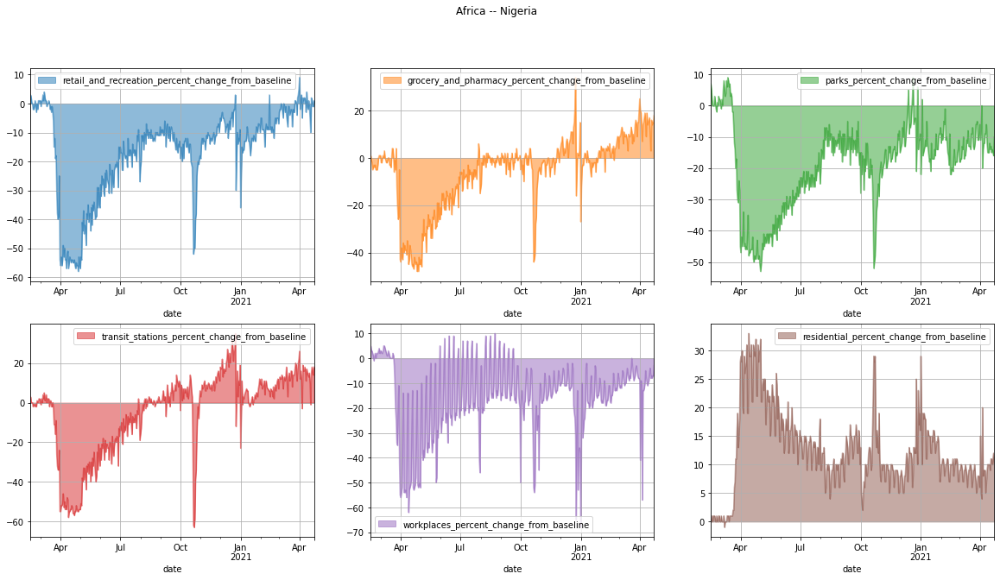

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


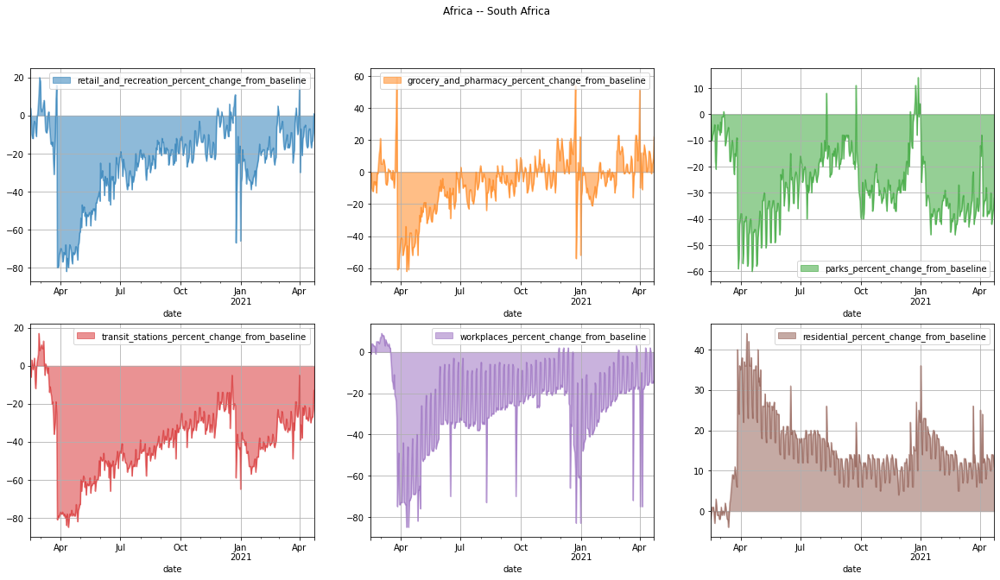

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


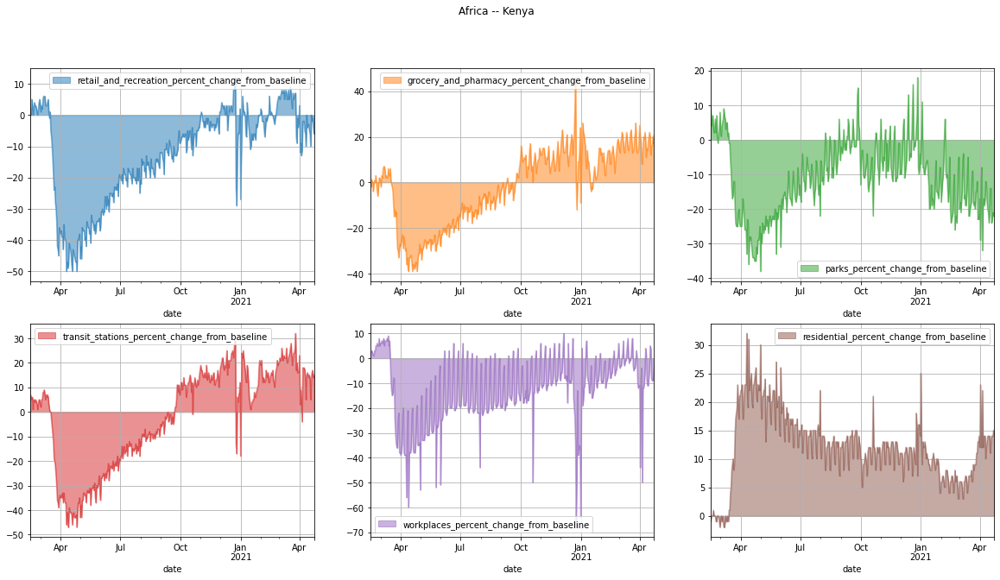

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


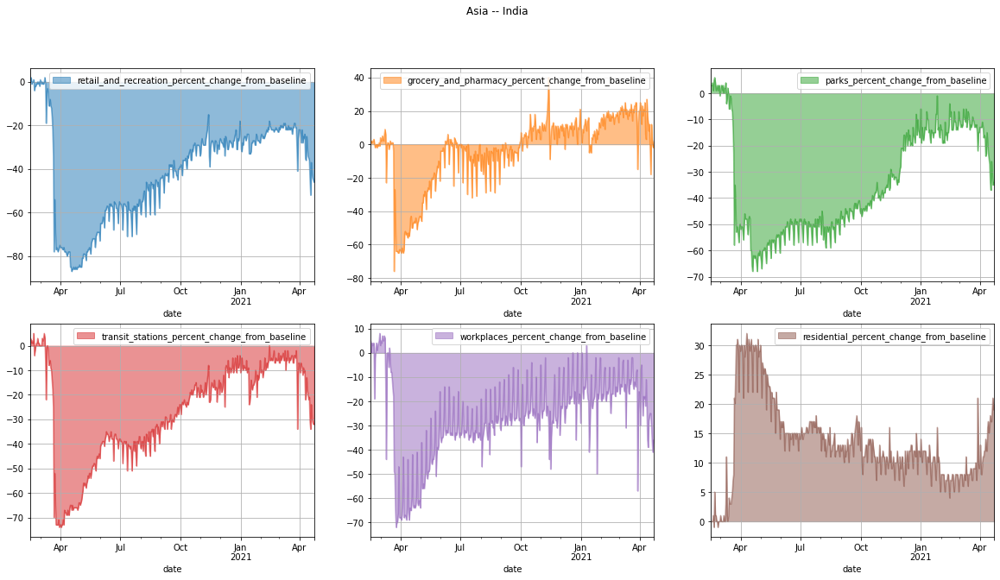

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


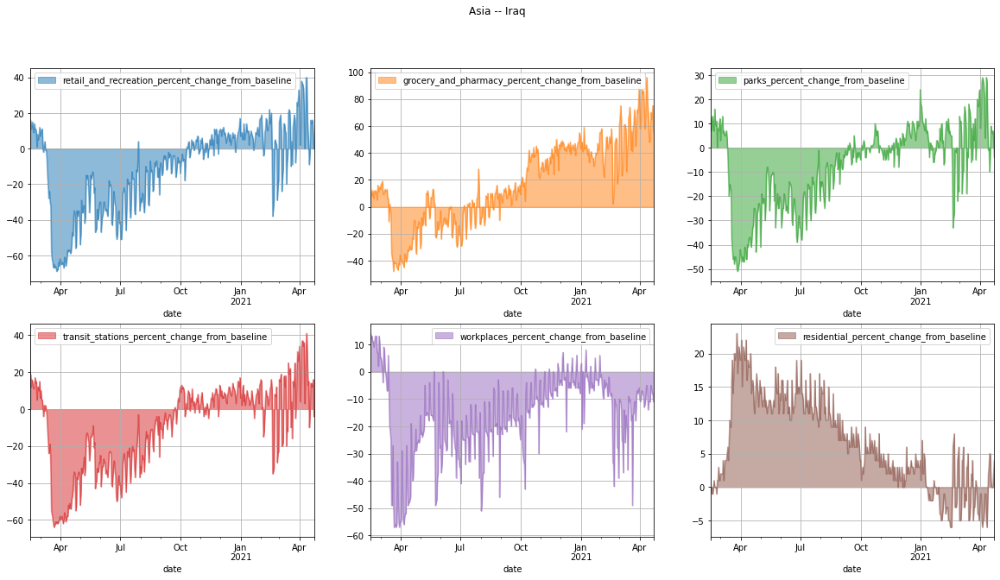

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


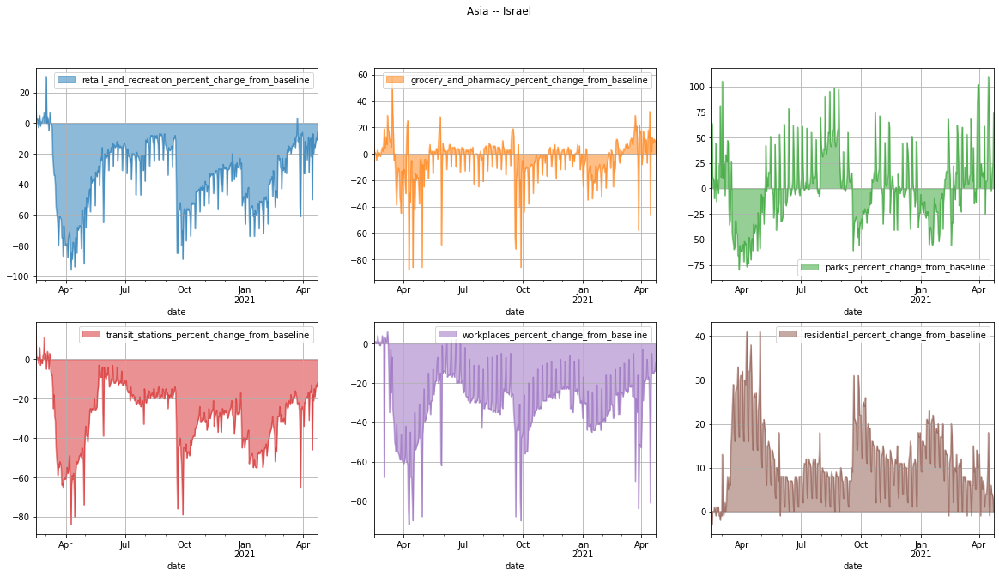

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


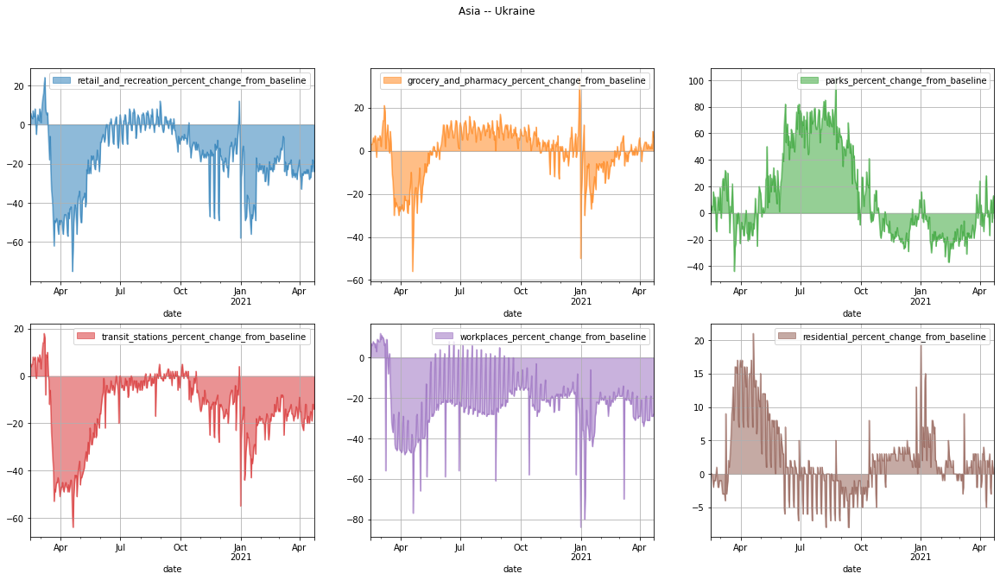

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


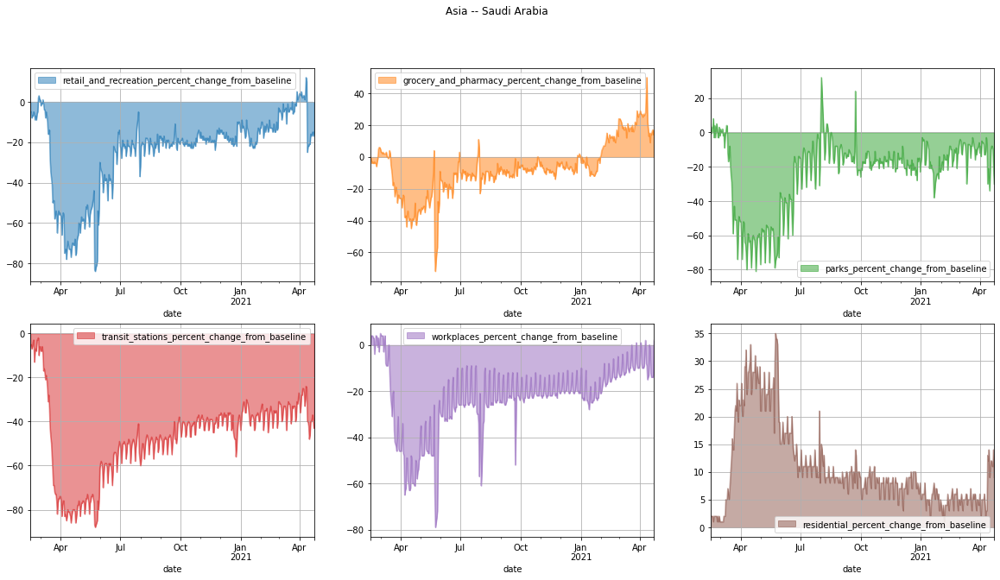

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


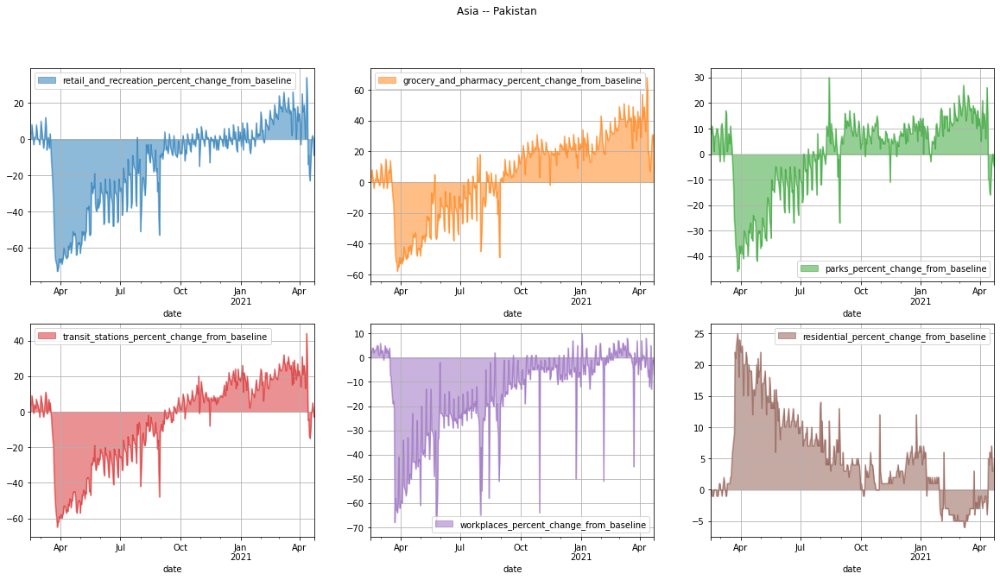

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


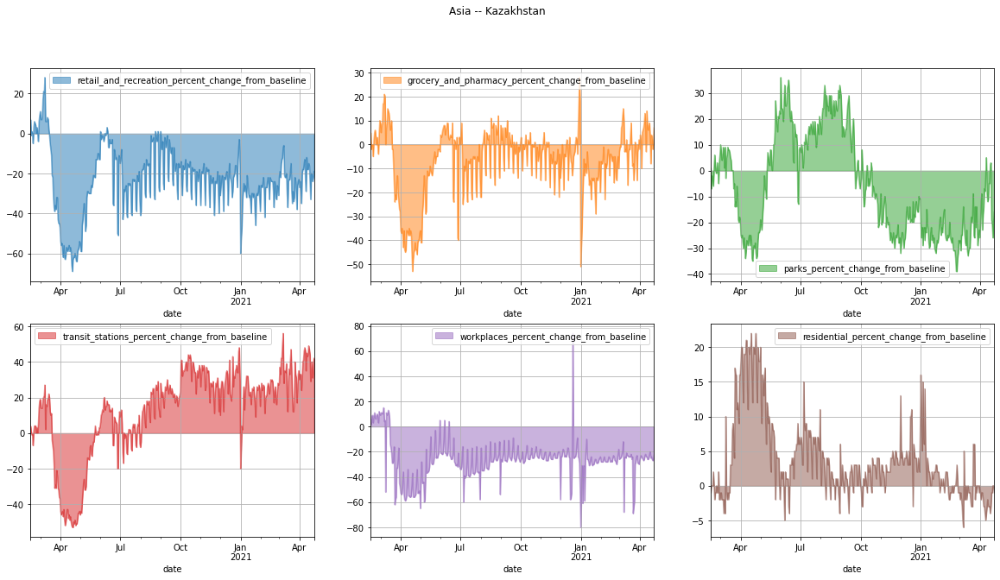

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


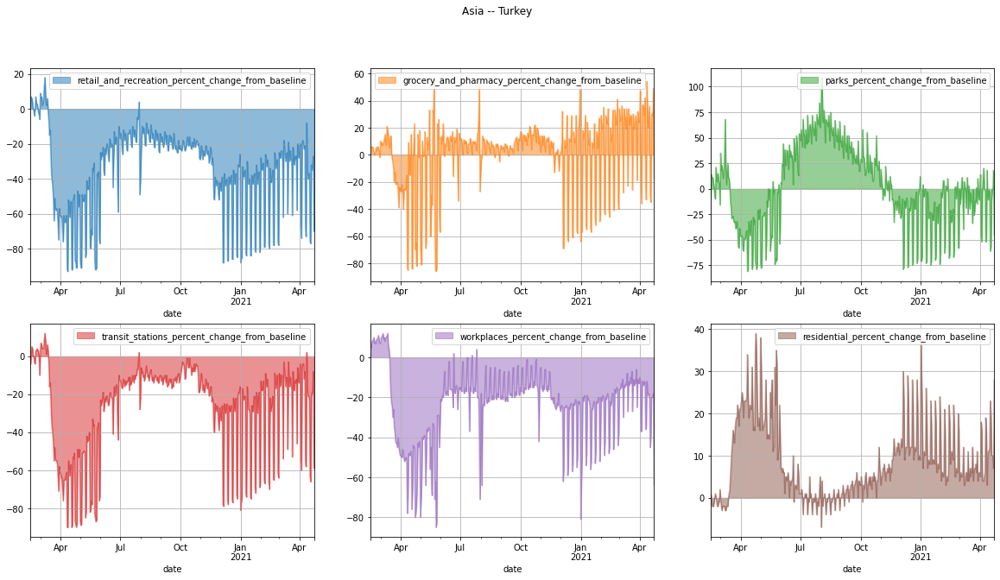

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


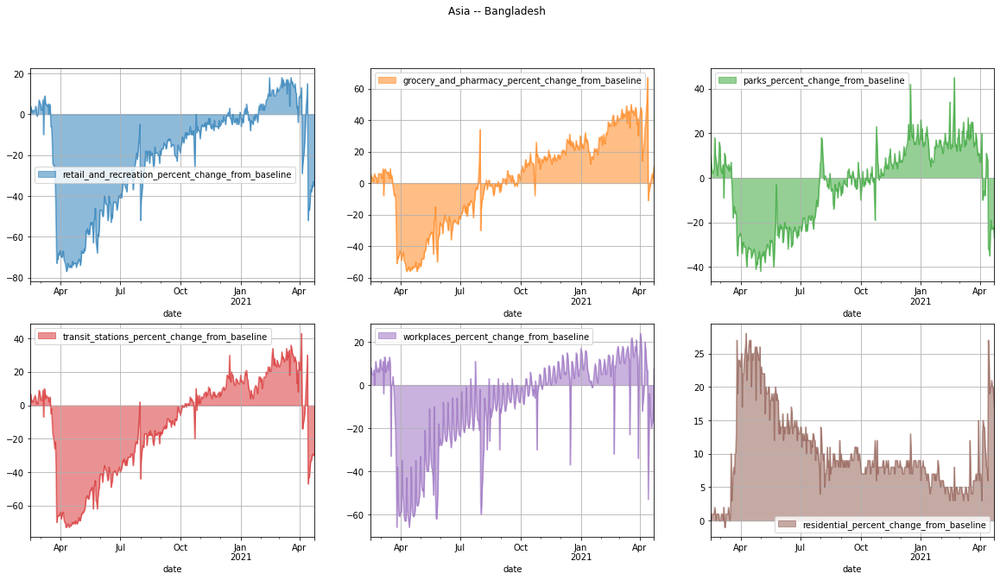

In [9]:
!mkdir -p mobility
for area, samples in Areas.items():
    for c in samples:
#        print("Trying %s -- %s"%(area, c))
        fig, ax = plt.subplots(figsize=(20,10))
        subdf = df.loc[df["country_region"] == c].loc[df["sub_region_1"].isnull()].loc[df["sub_region_2"].isnull()].loc[df["metro_area"].isnull()].sort_values("date")
        subdf.plot(kind="area", stacked=False, x="date", y=situations, title="%s -- %s"%(area,c), ax=ax, subplots=True, layout=(2,3), grid=True)
        ax.legend(sit_legends)
        ax.xaxis_date()
        ax.set_ylabel("% to baseline")
        display(fig)
        plt.savefig("mobility/%s-%s.png"%(area, c), facecolor="white")
        plt.close(fig)

## 日本の県別表示
日本の移動量を県別に表示する

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


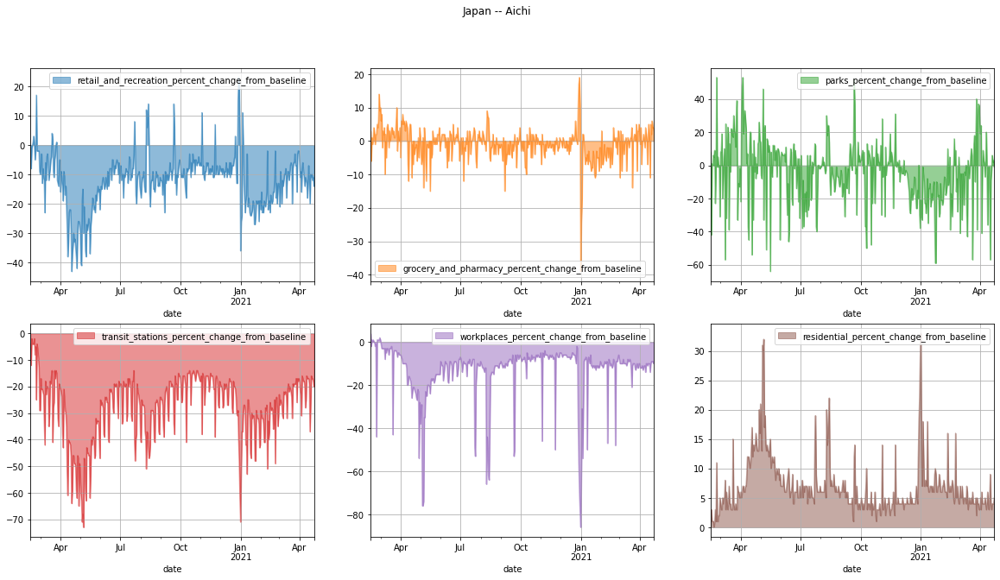

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


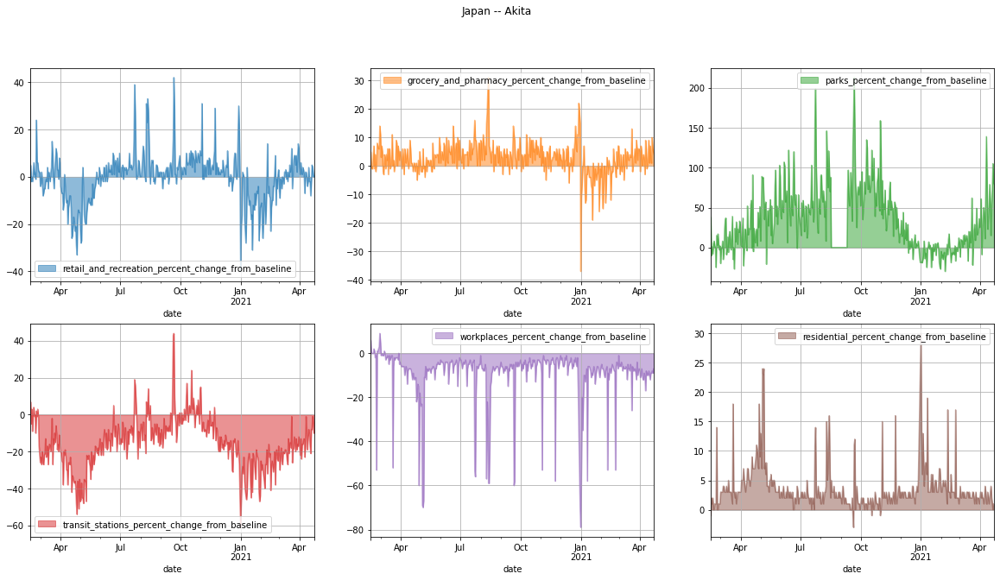

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


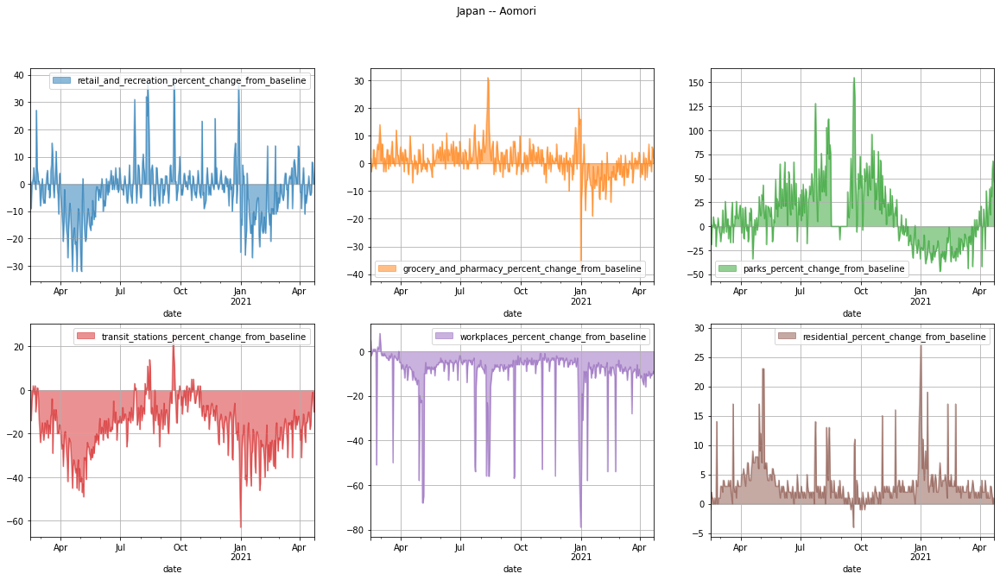

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


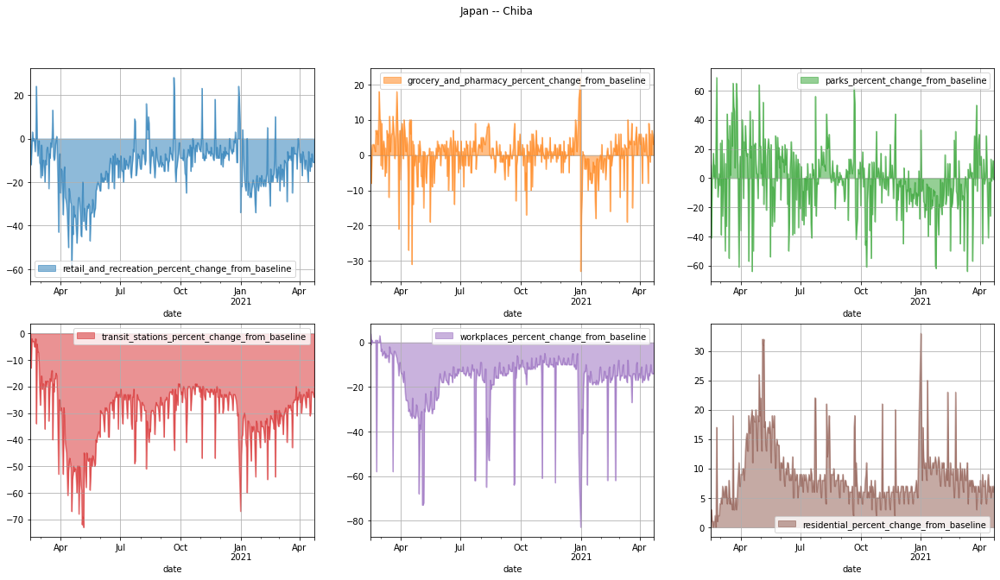

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


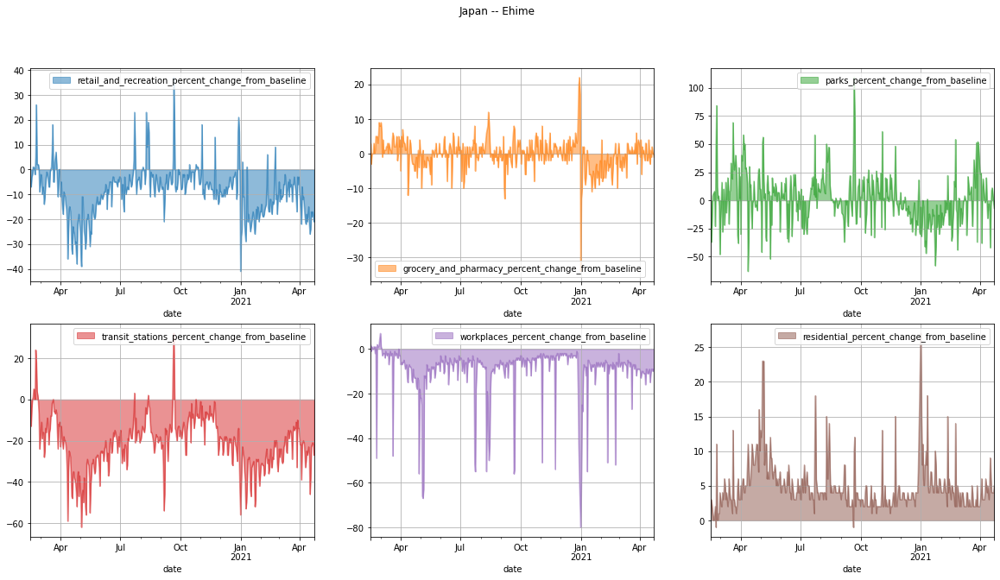

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


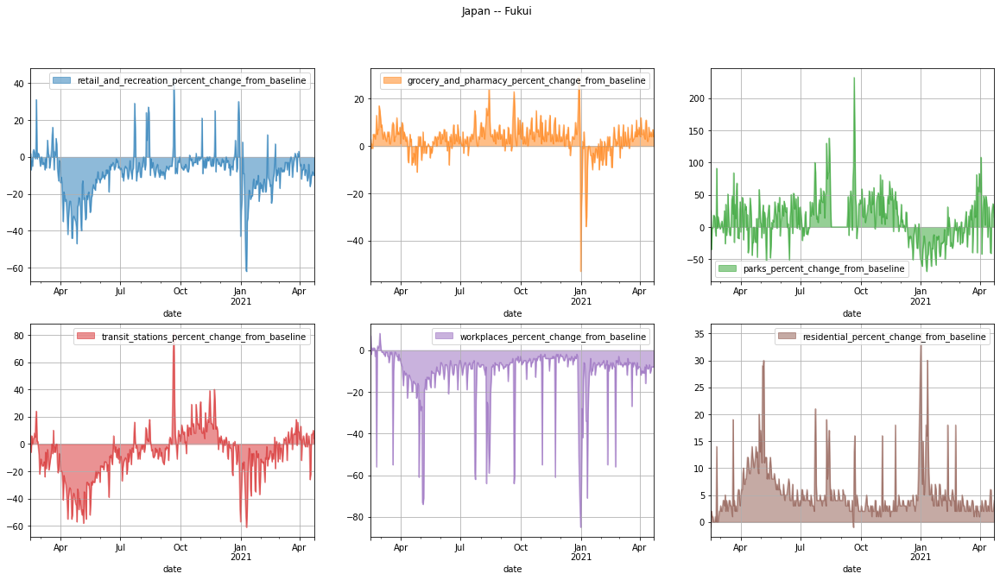

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


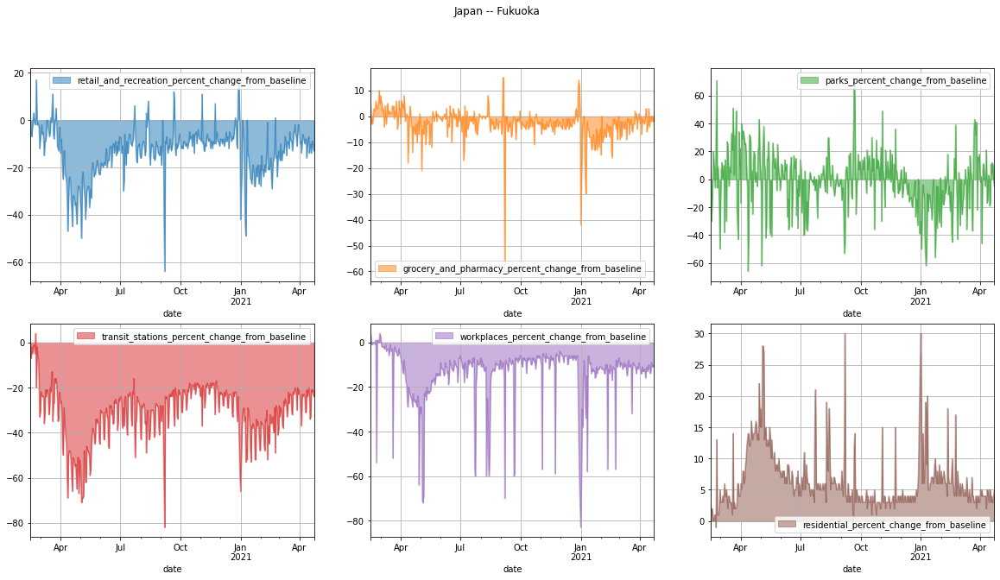

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


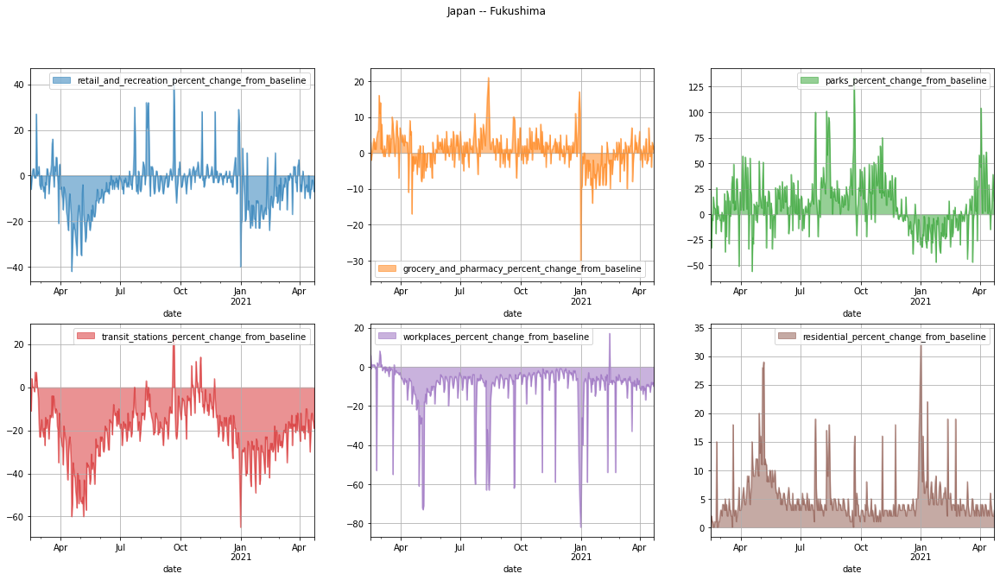

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


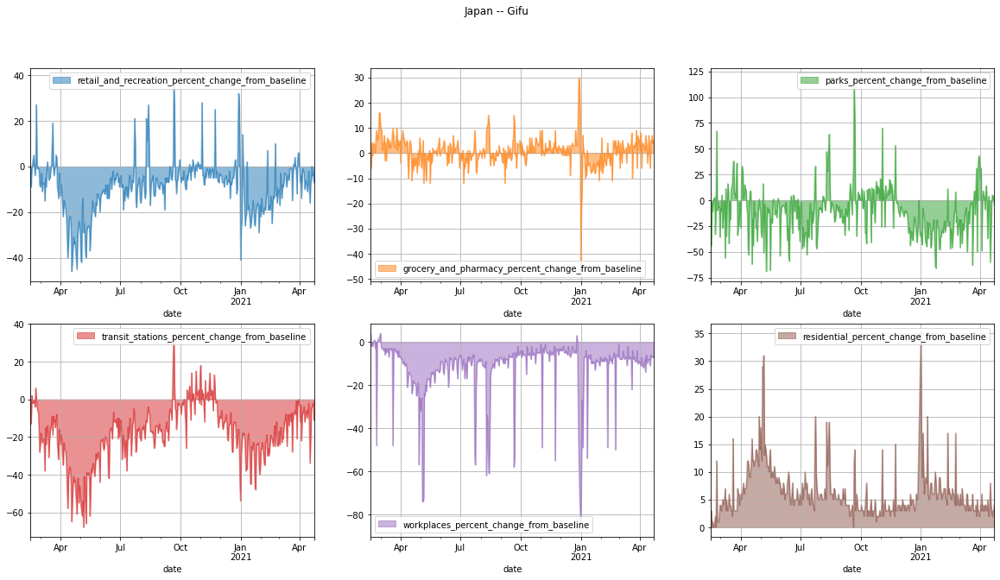

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


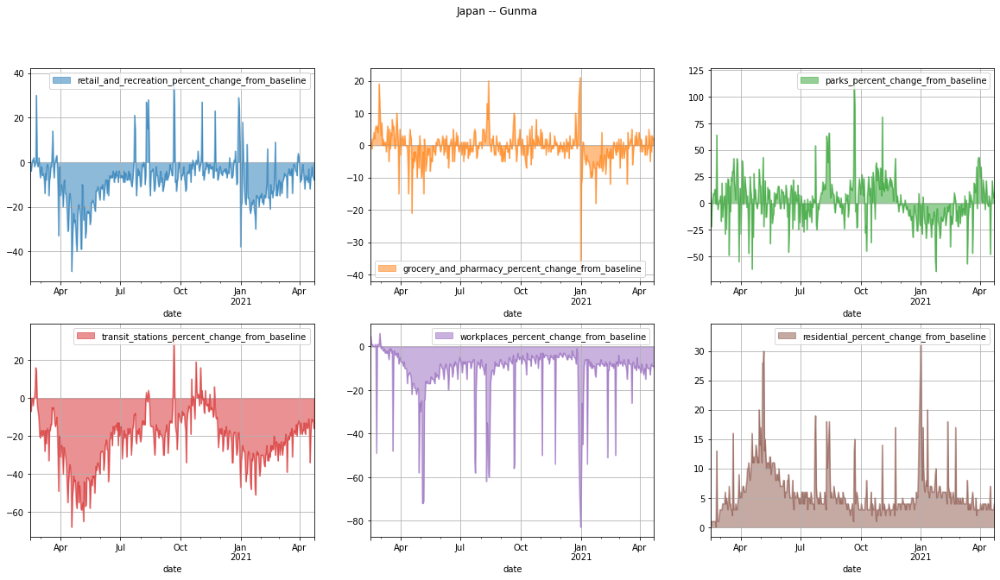

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


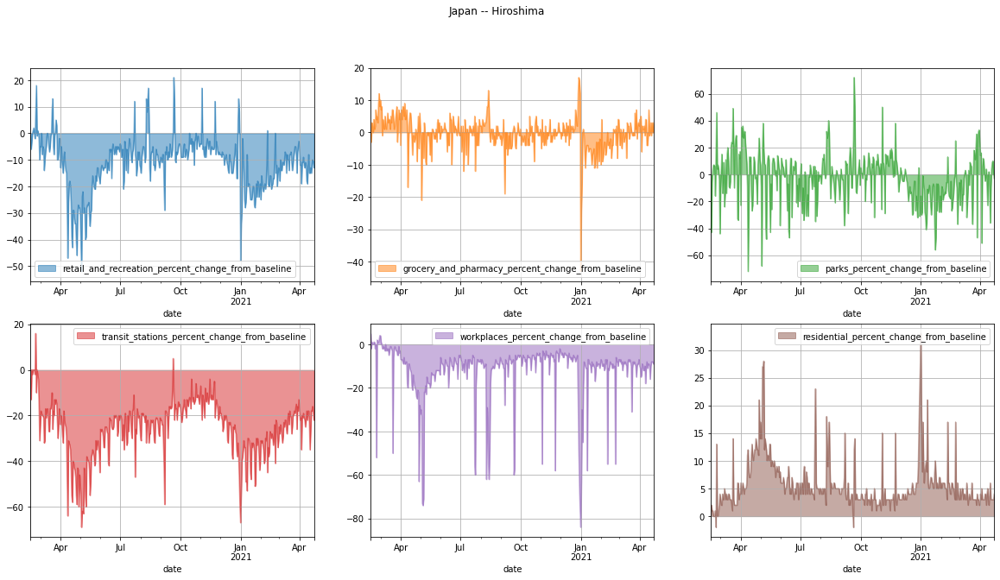

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


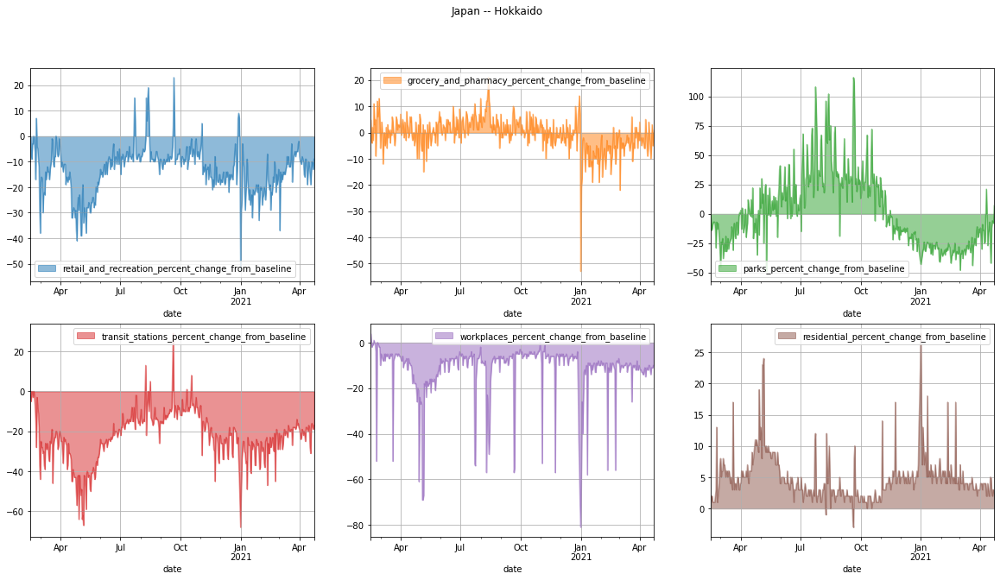

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


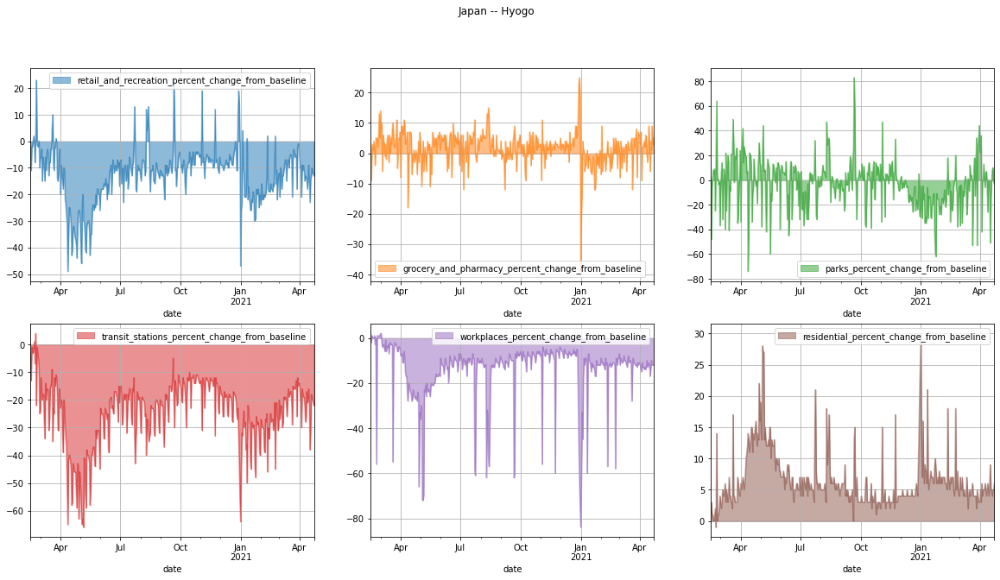

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


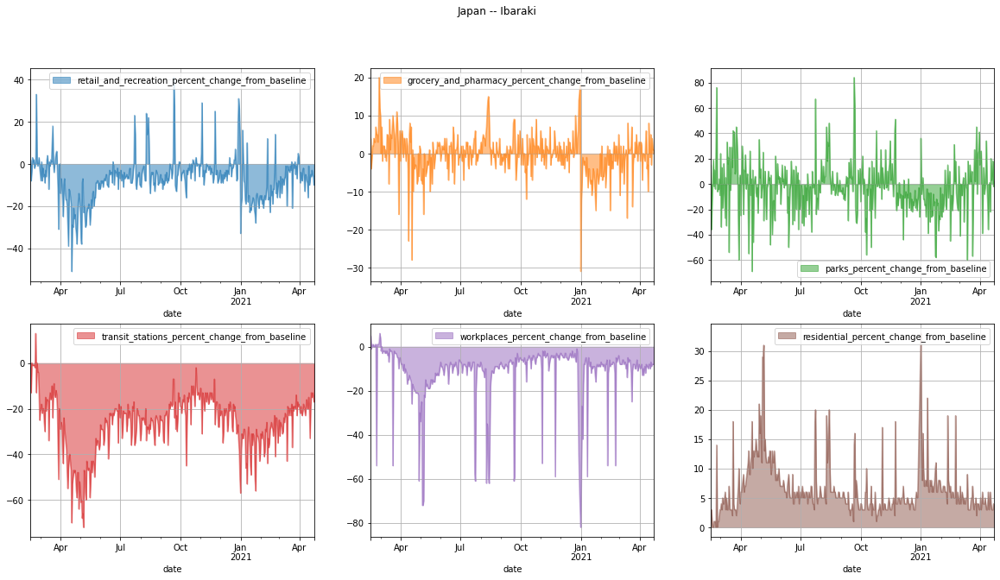

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


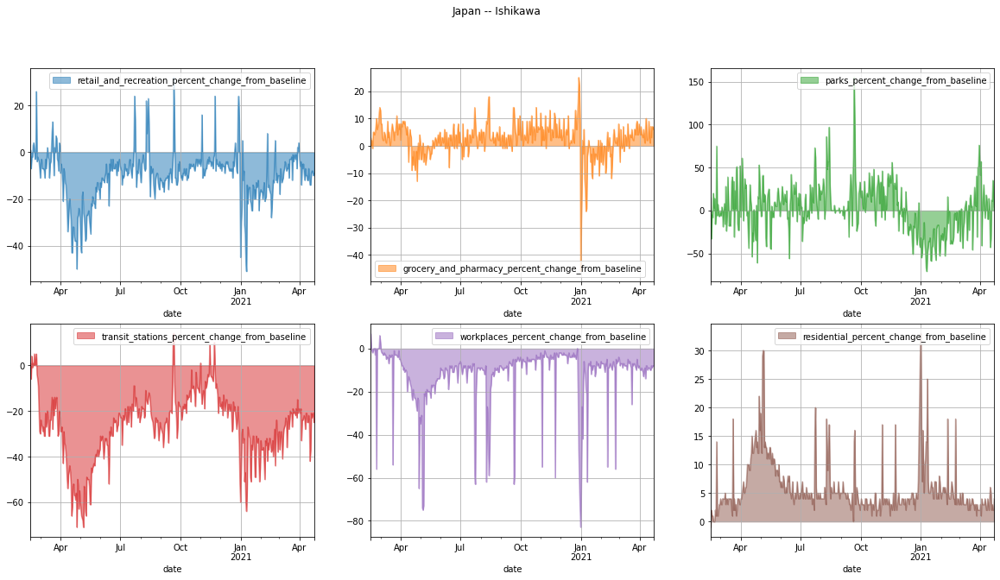

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


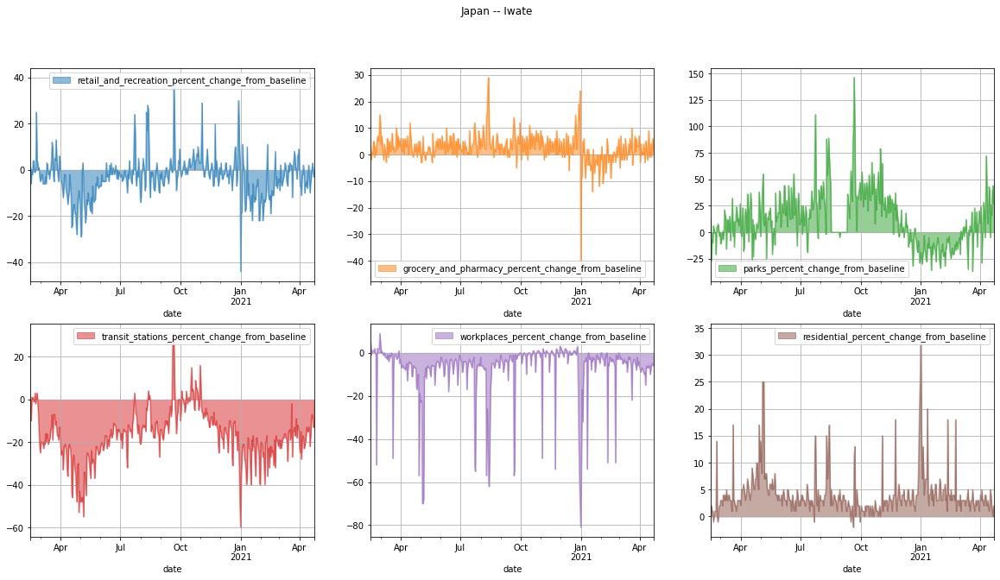

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


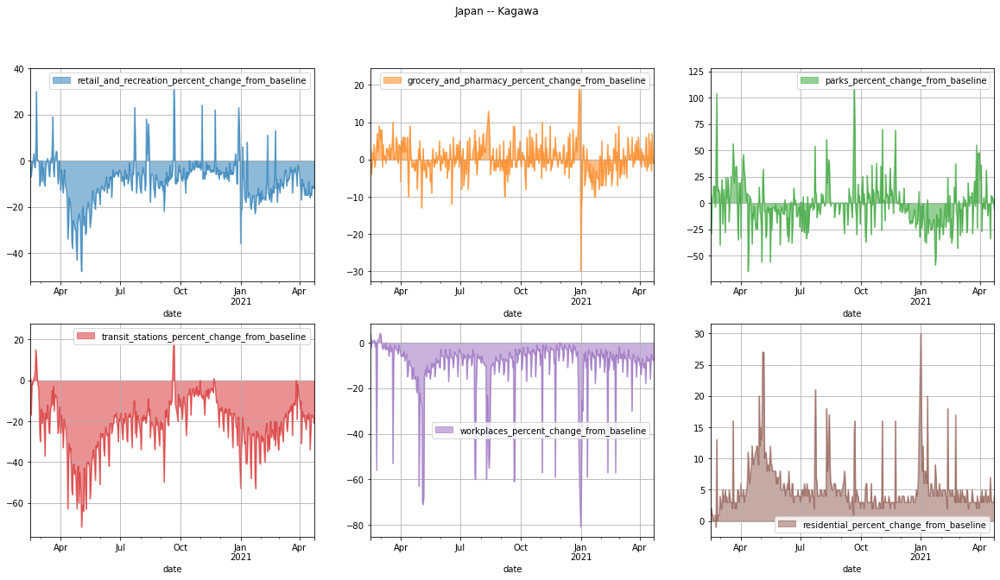

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


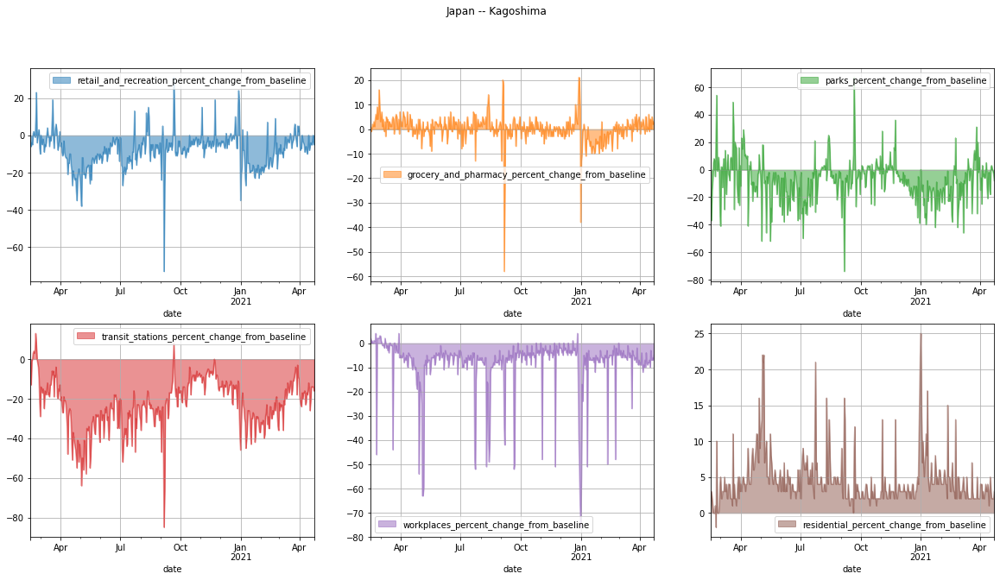

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


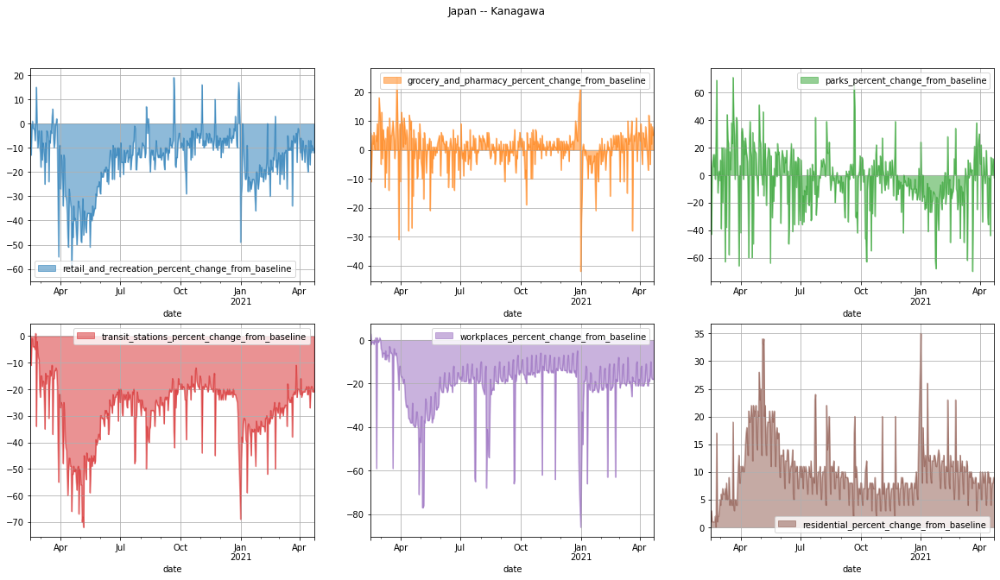

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


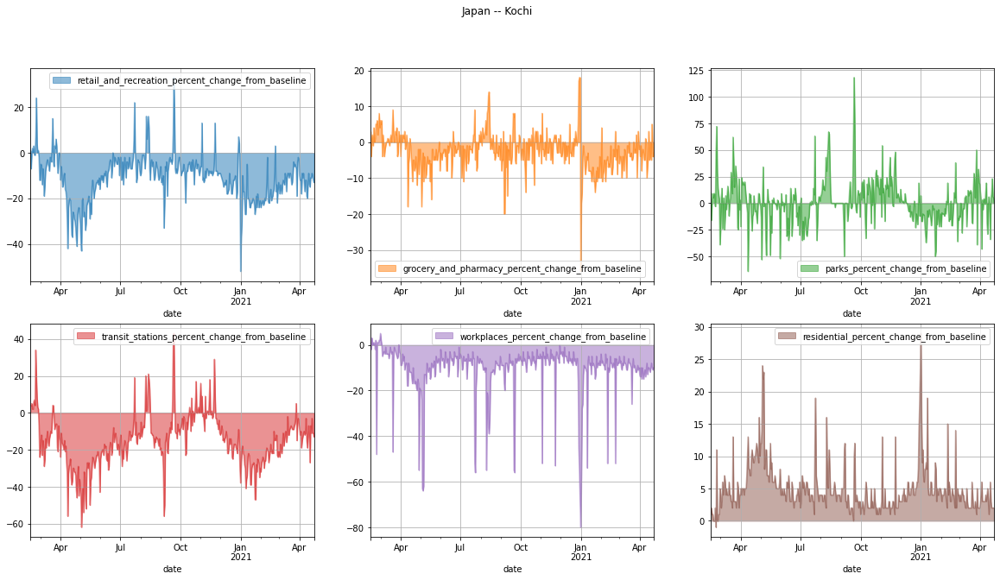

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


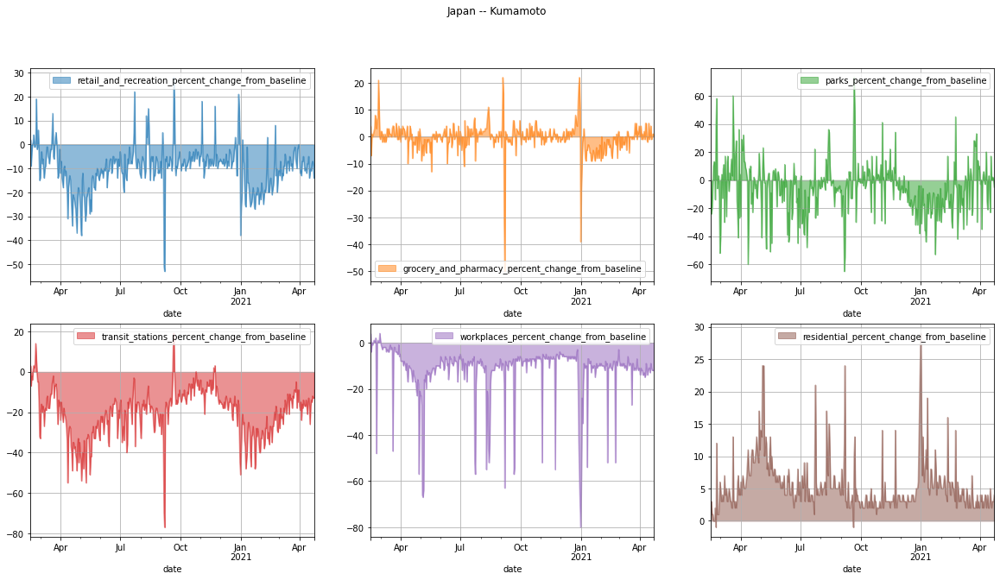

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


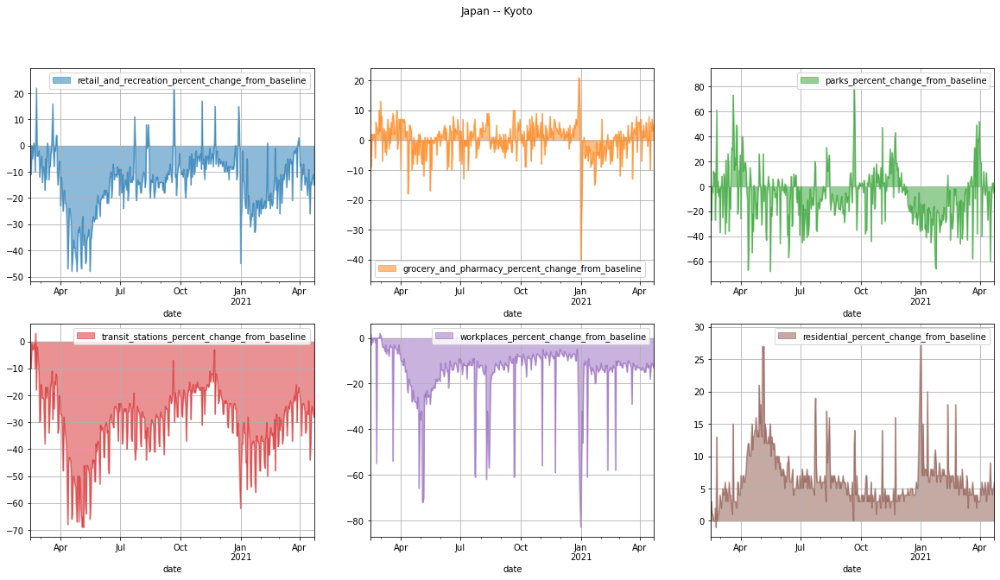

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


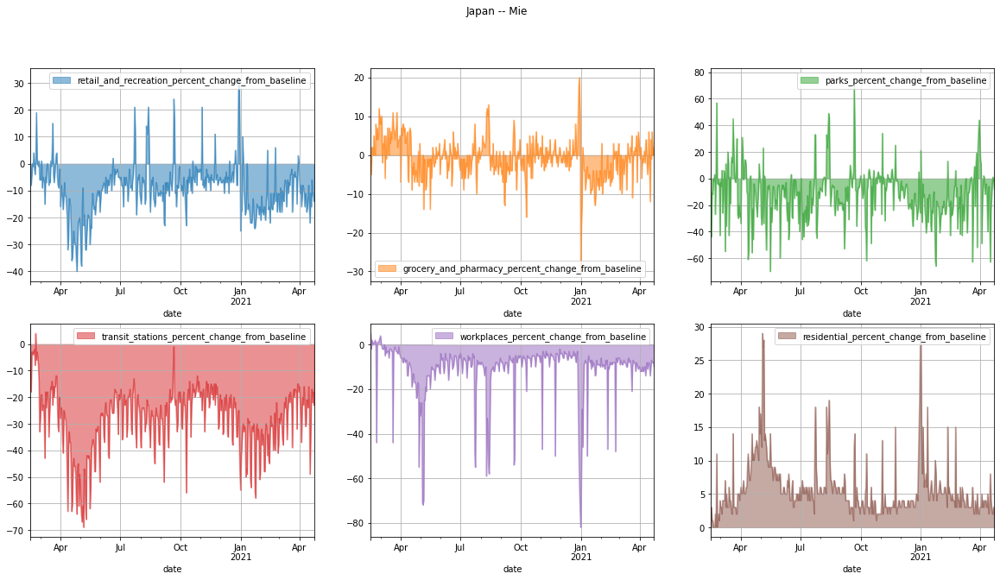

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


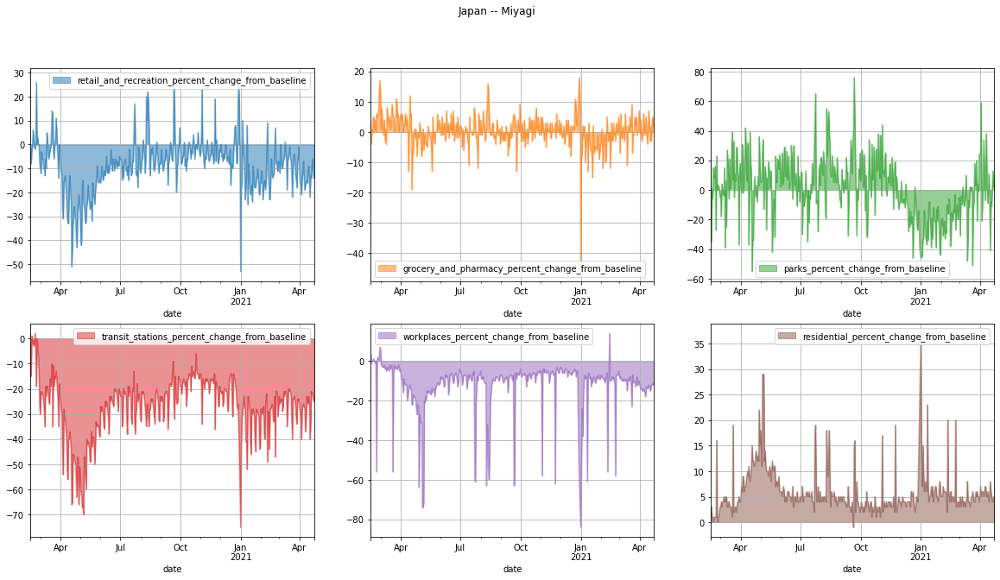

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


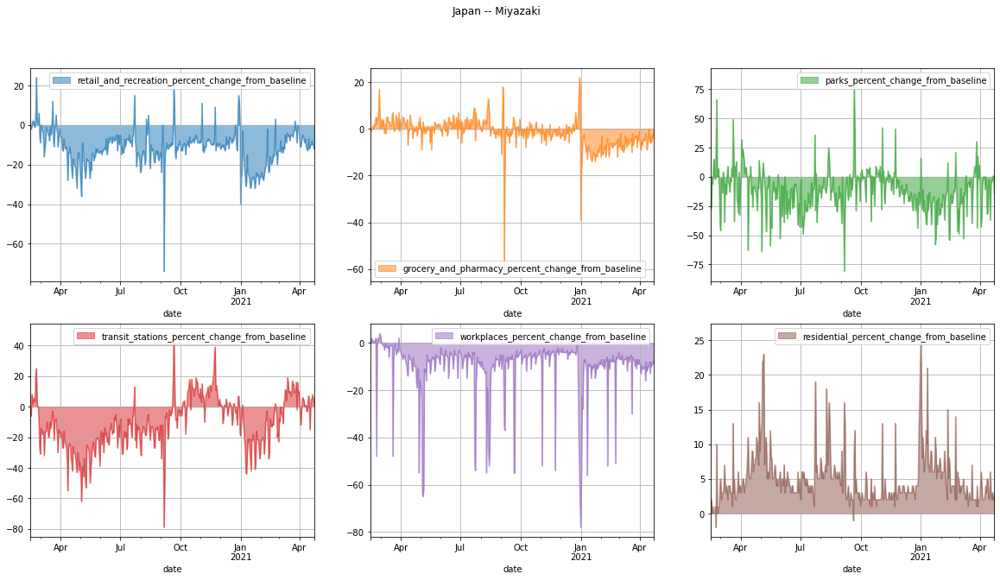

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


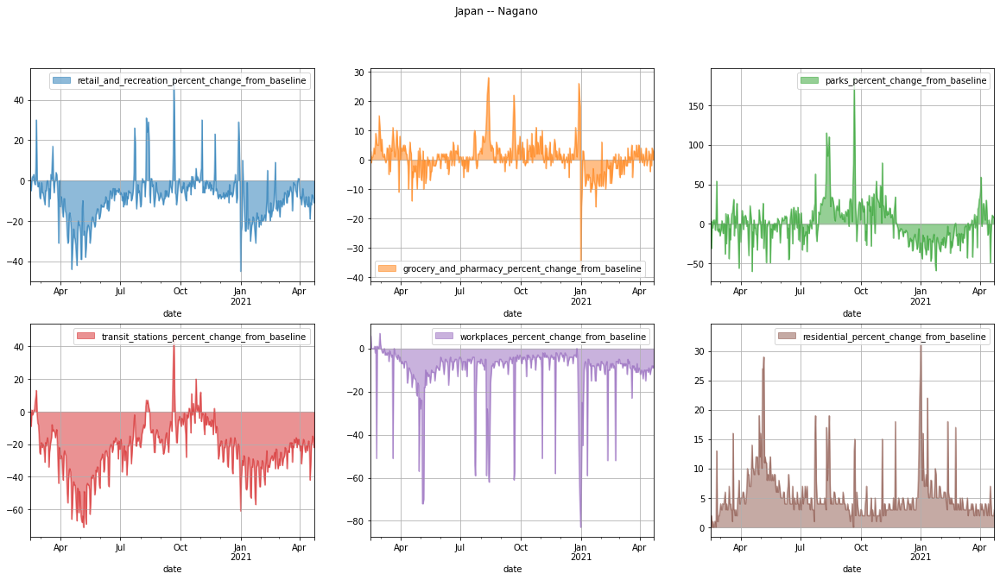

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


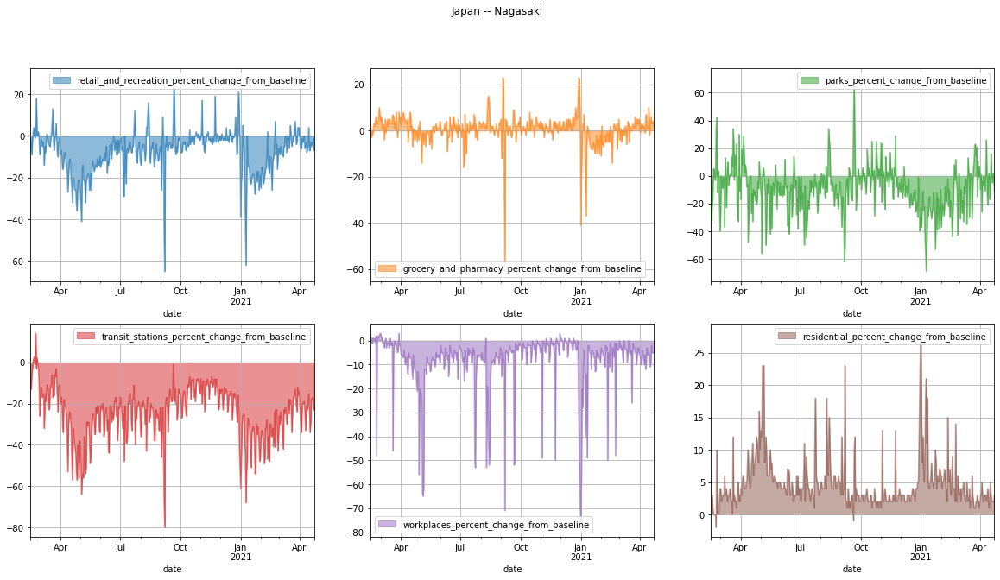

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


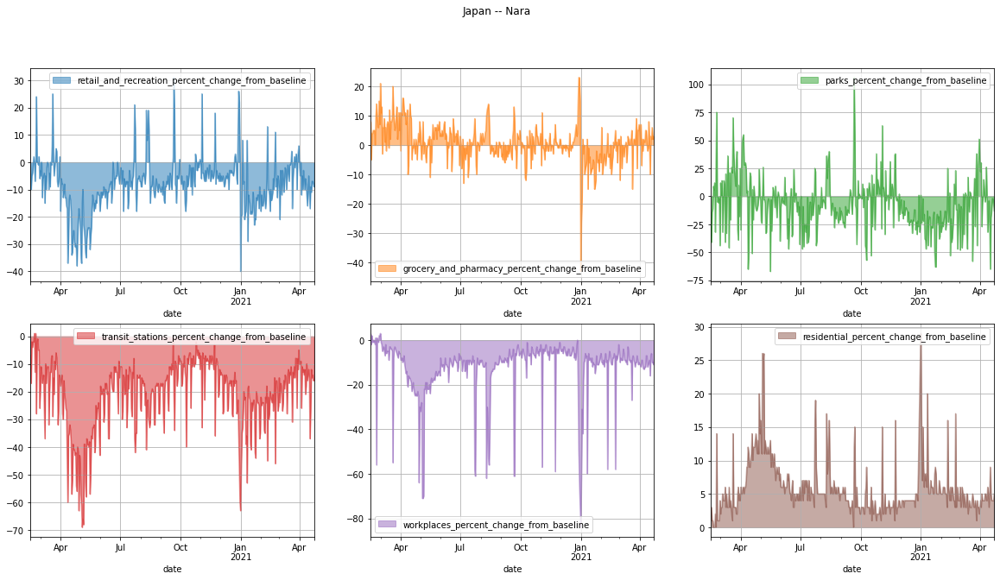

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


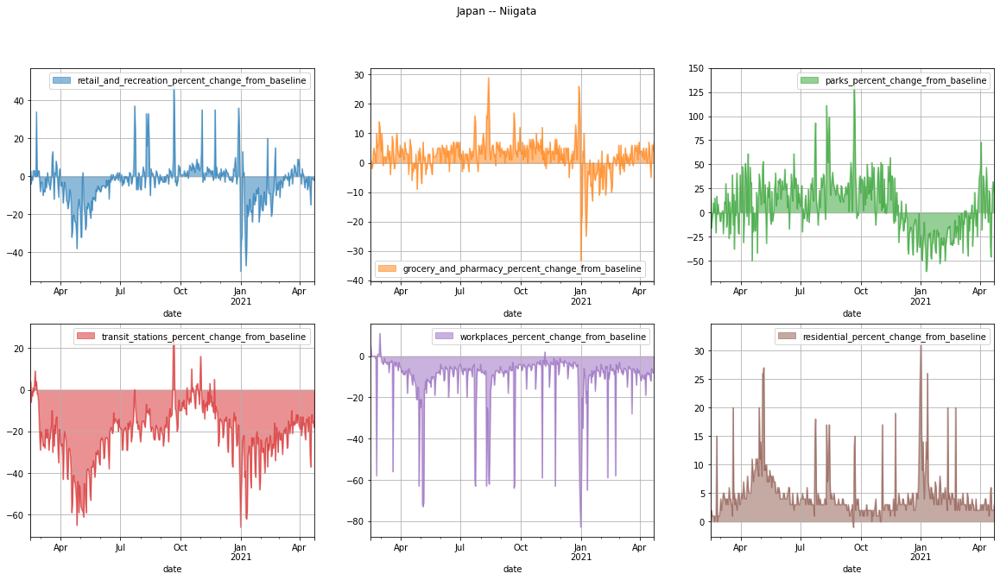

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


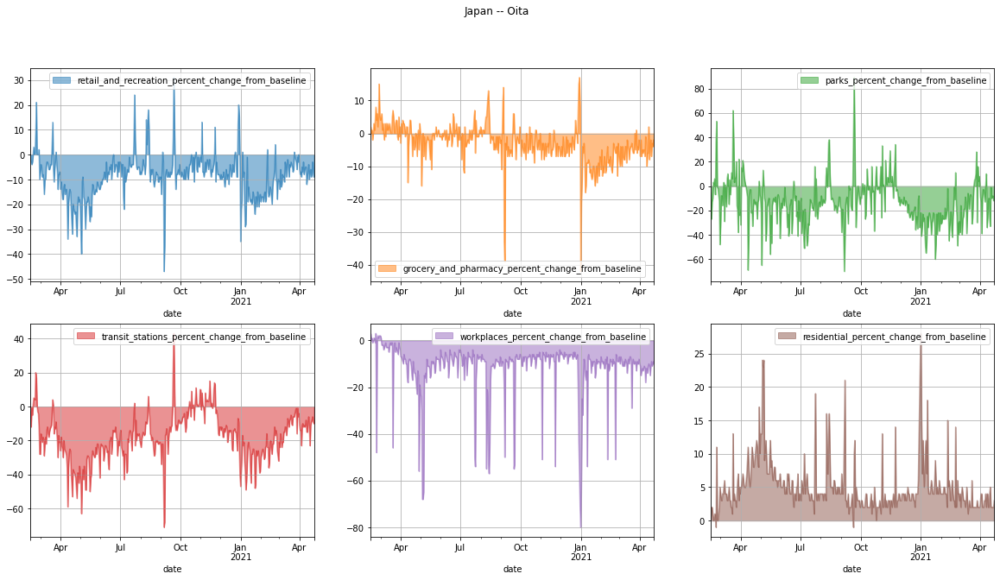

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


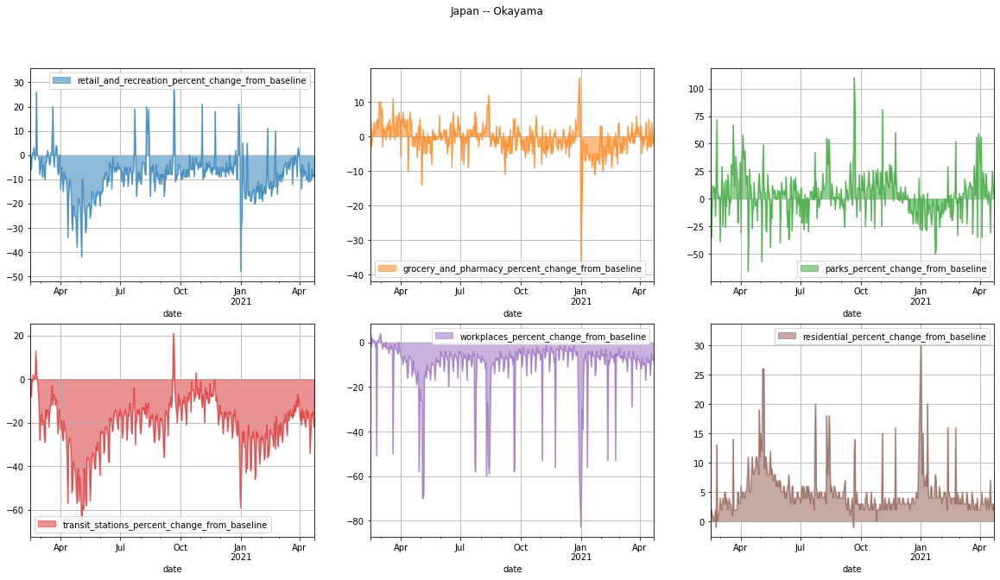

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


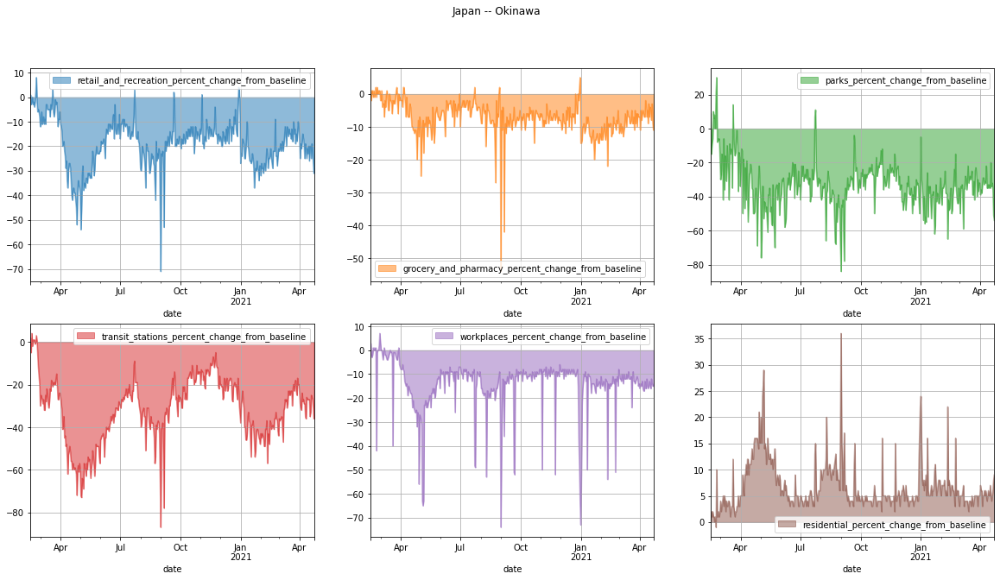

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


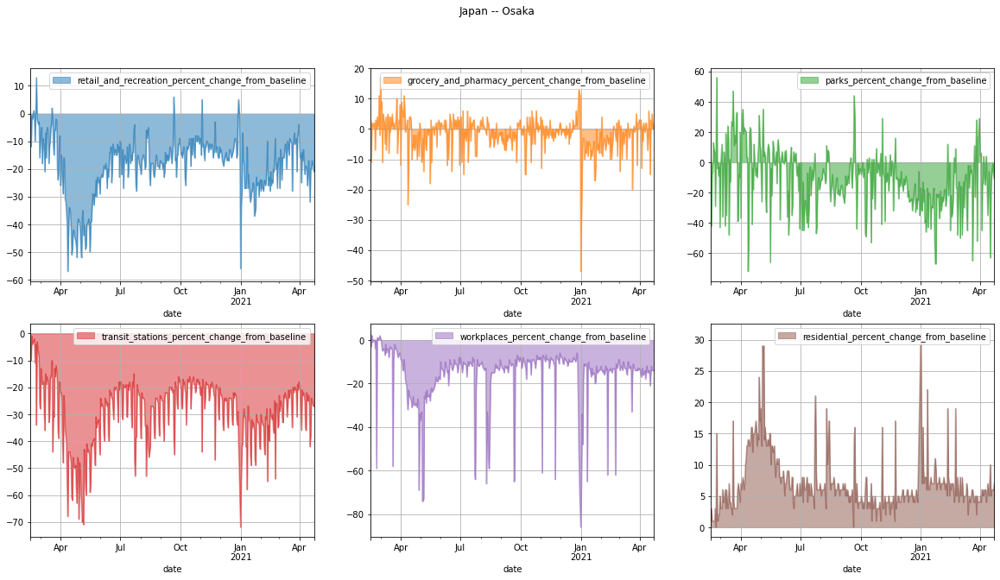

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


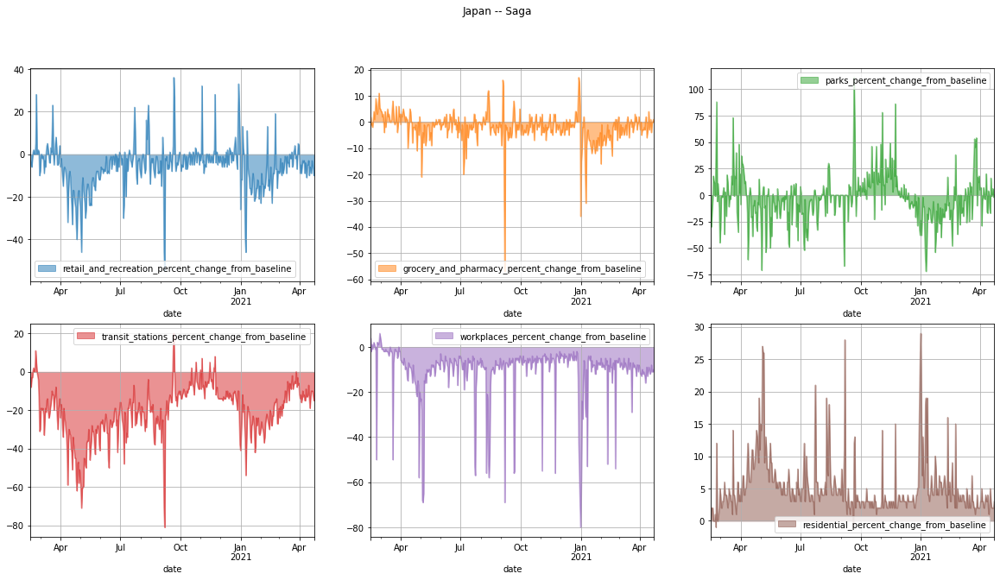

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


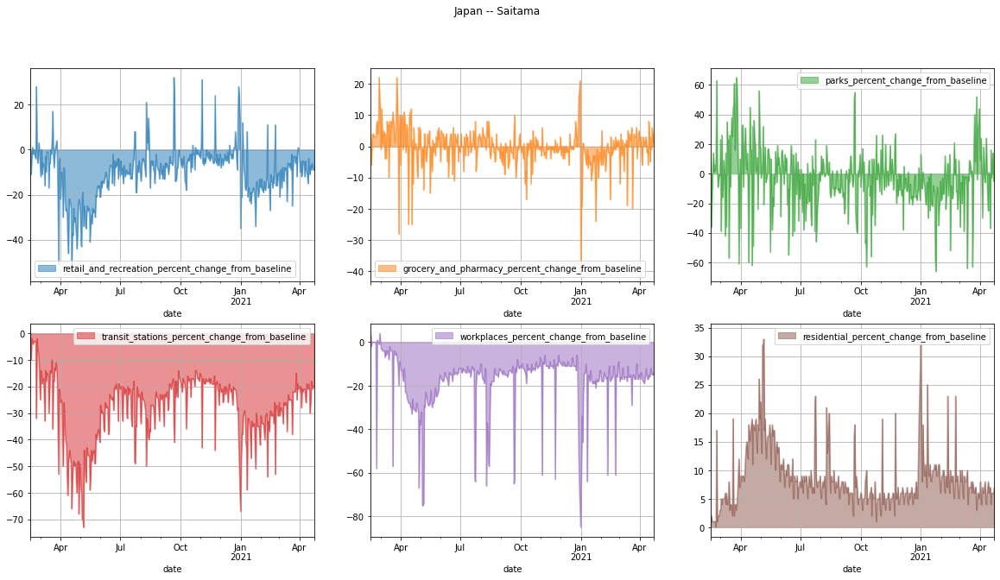

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


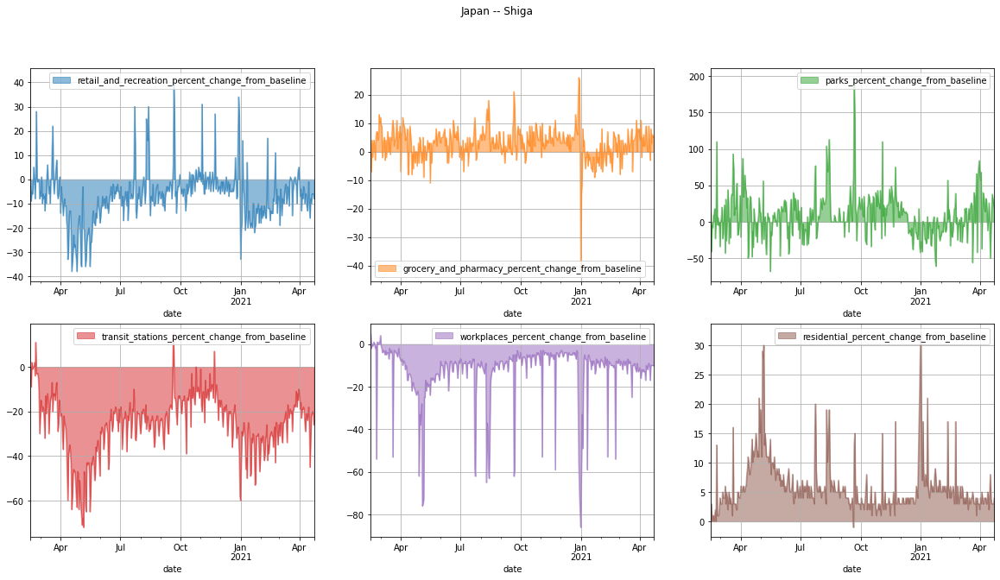

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


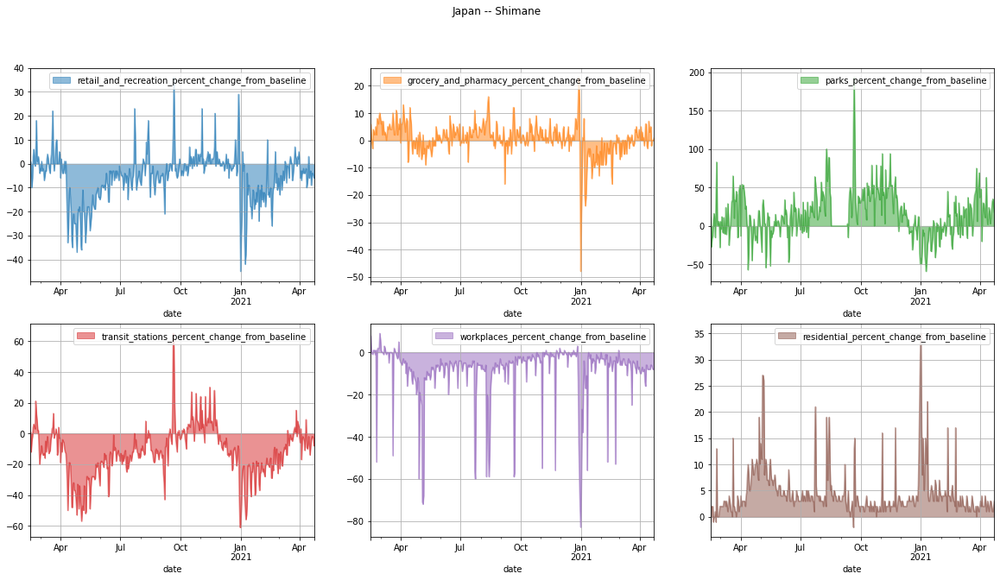

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


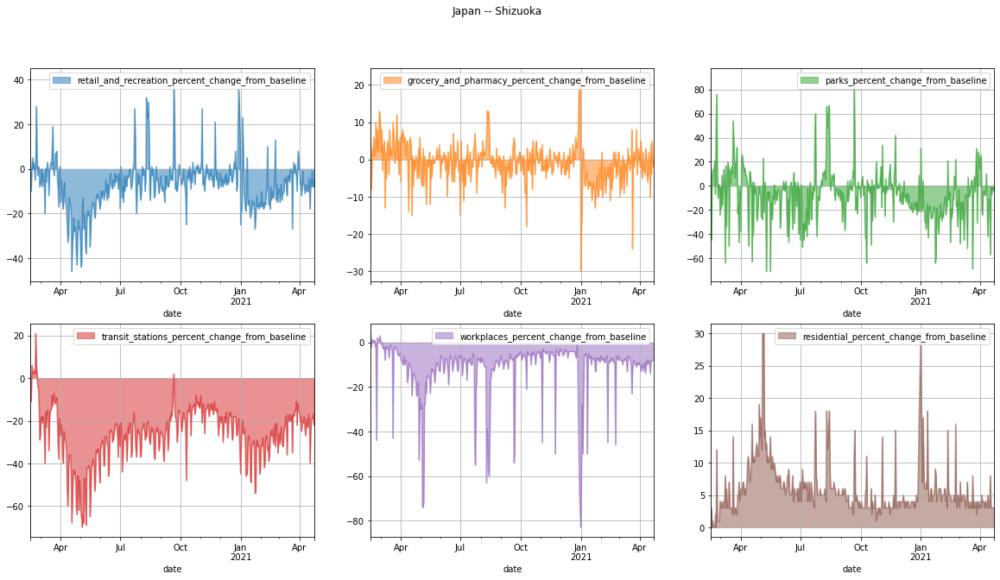

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


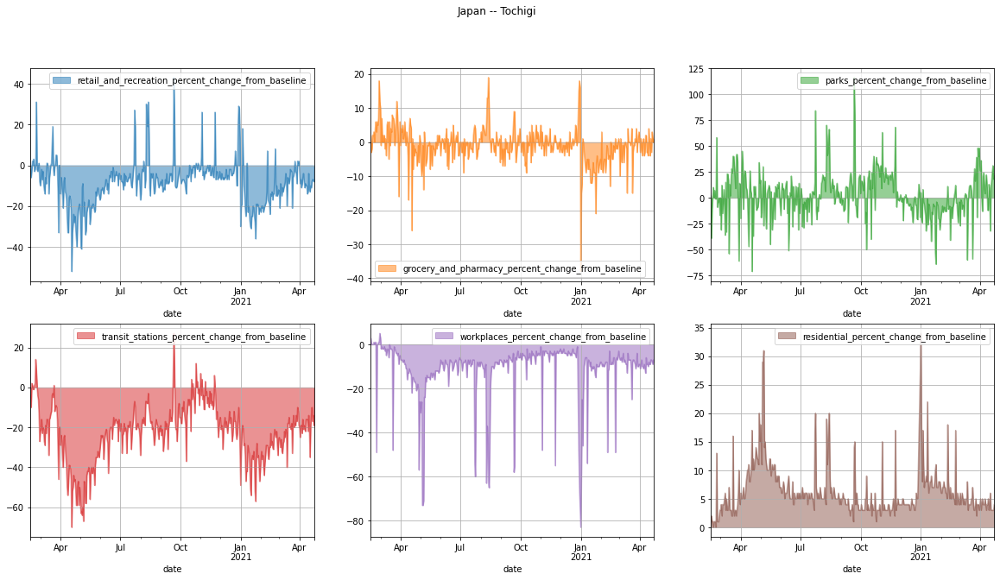

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


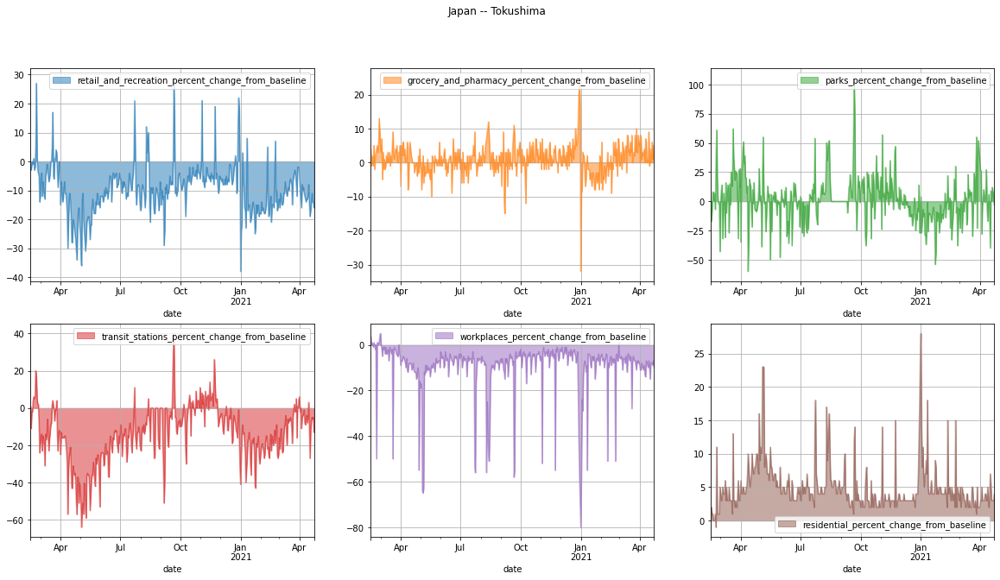

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


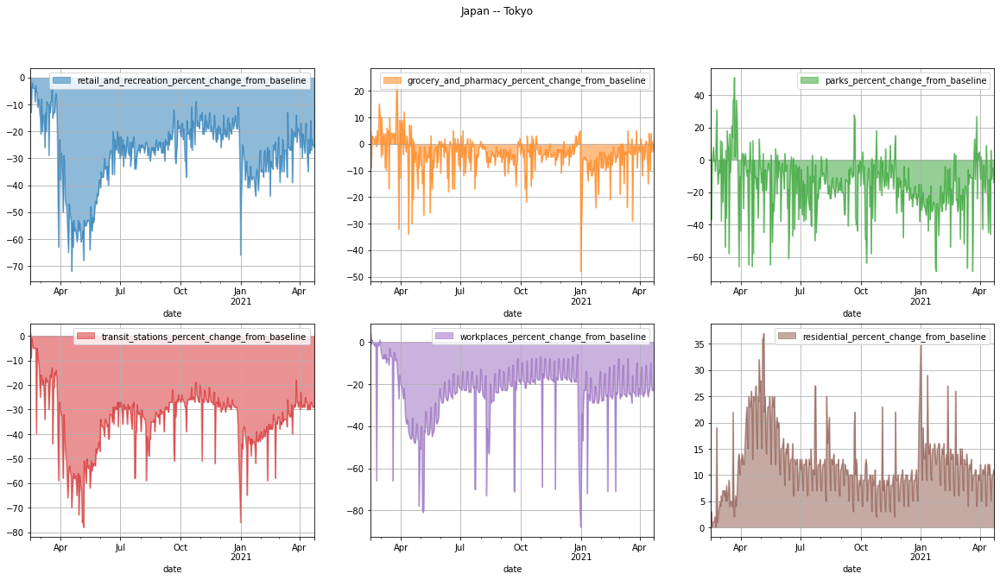

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


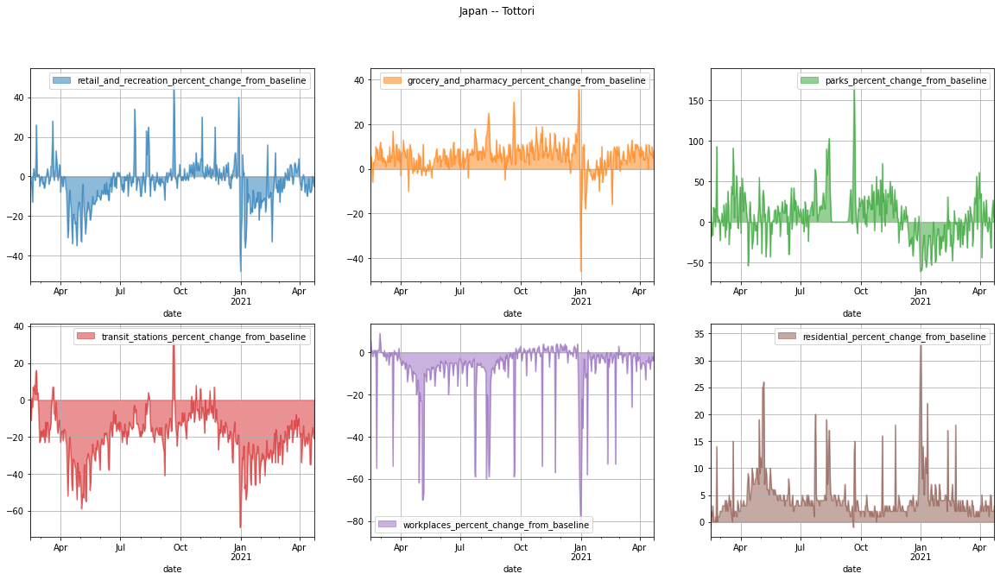

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


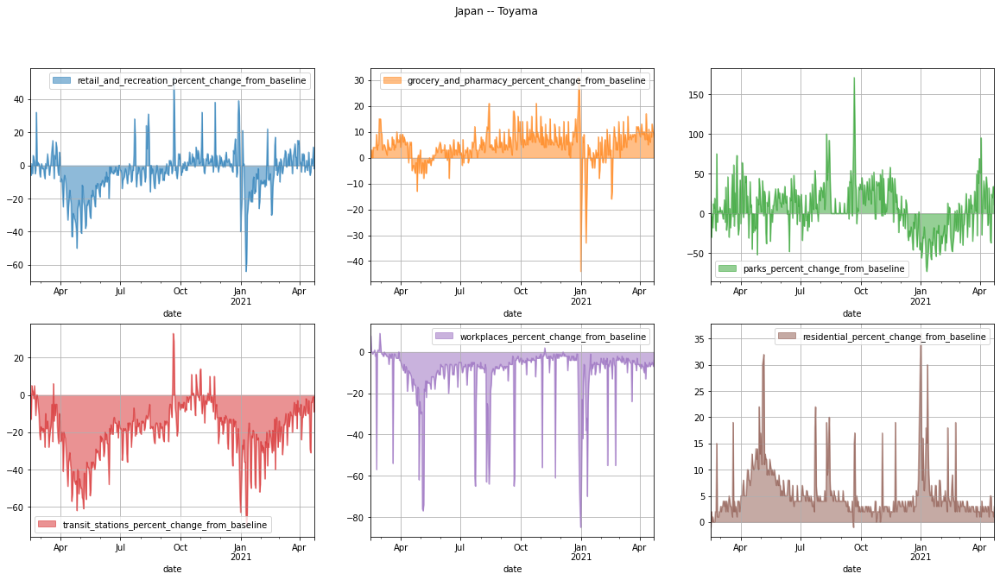

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


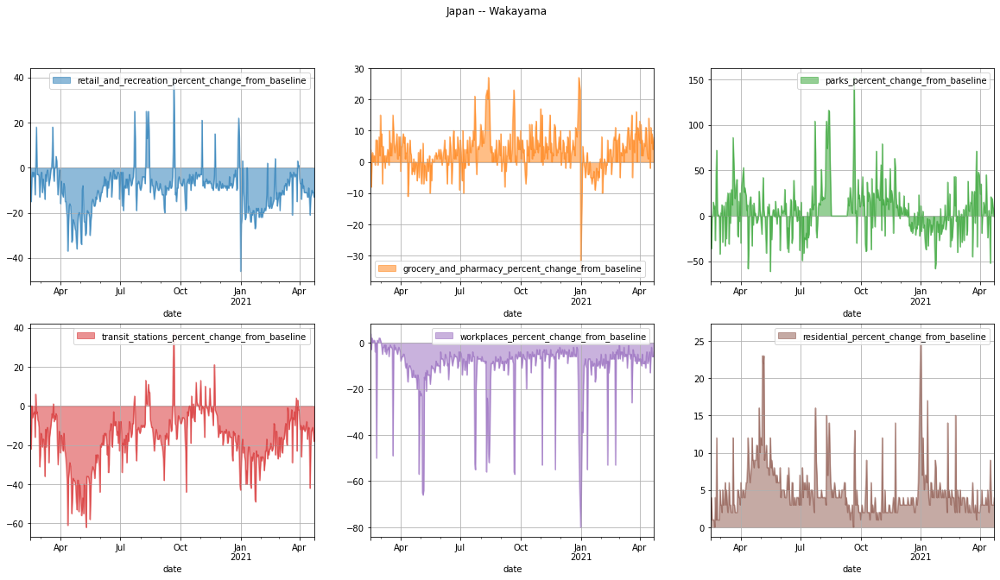

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


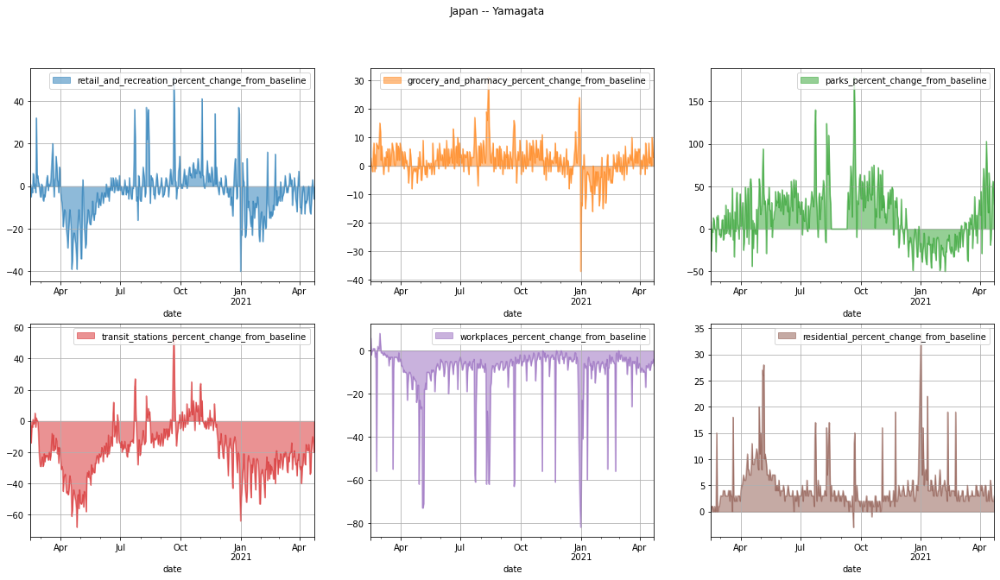

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


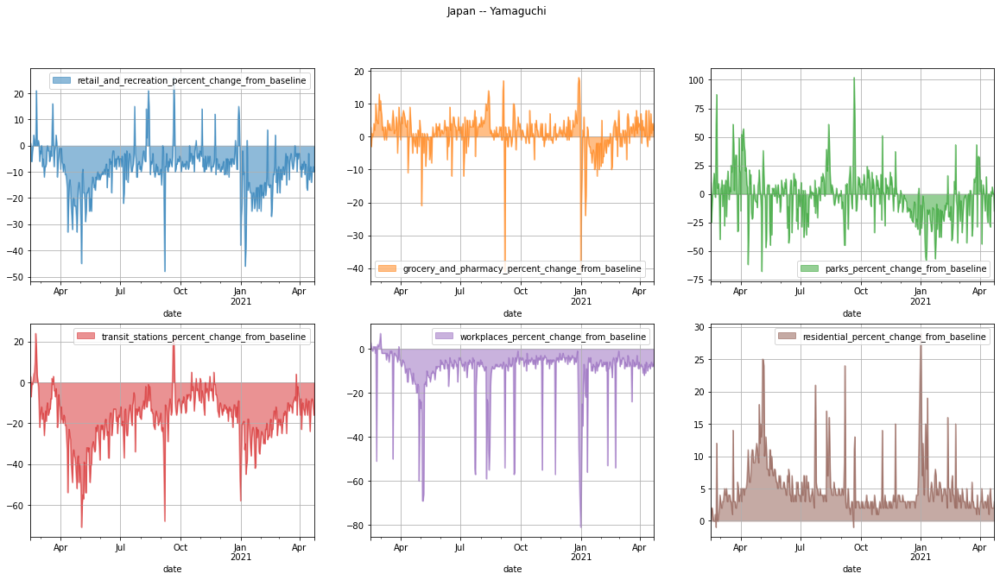

/home/seagetch/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


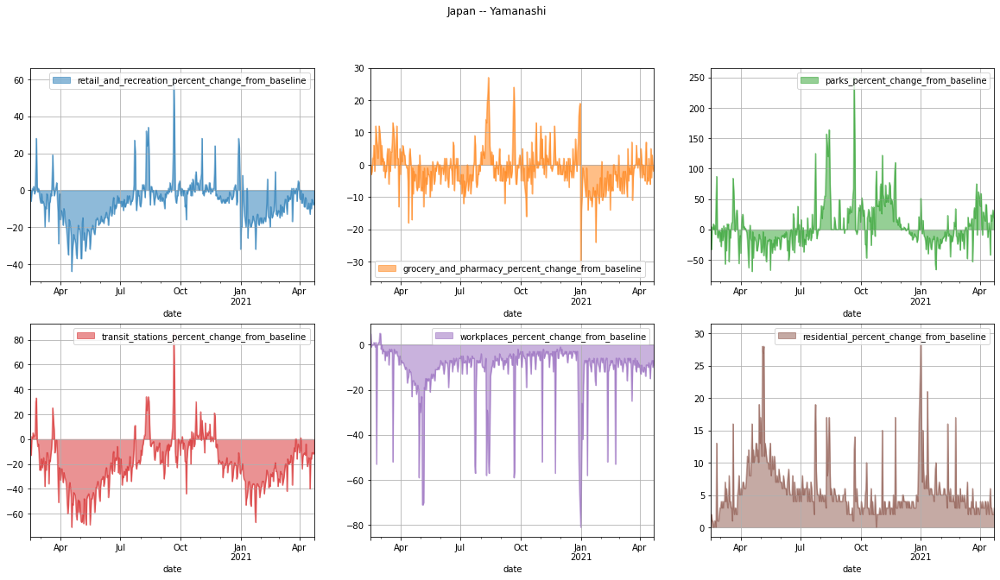

In [10]:
!mkdir -p mobility/japan

c="Japan"
subdf = df.loc[df["country_region"] == c].loc[df["sub_region_1"].notnull()]
subgroup = subdf.groupby("sub_region_1")
for p, ssdf in subgroup:
    fig, ax = plt.subplots(figsize=(20,10))
#    print("Trying %s -- %s"%(c, p))
    ssdf.plot(kind="area", stacked=False, x="date", y=situations, title="%s -- %s"%(c,p), ax=ax, subplots=True, layout=(2,3), grid=True)
    display(fig)
    plt.savefig("mobility/japan/%s-%s.png"%(c, p), facecolor="white")
    plt.close(fig)